<a href="https://colab.research.google.com/github/alexrafkin/nba_player_roles/blob/main/NBAPlayerRoles.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Abstract

In this project I plan to leverage my understanding of both unsupervised learning and the NBA to define the five main roles that every NBA team is and has been composed of. I use the career statistical output of all NBA players to build various clustering models and then evaluate the clusters quantitatively and qualitatively.

#Introduction

Since the pandemic hit, I have been having a lot more time on my hands. A lot of this time has been invested in following the NBA. Not only is basketball exciting to watch and follow, but it is filled with statistics. I think thats why I was initially drawn to it - there is a lot of statistical analysis being done within basketball. With so many intricate measures of players' values, impact and success, I wanted to tackle something a bit more broad.

Initially, I was aiming to evaluate the tiers of NBA careers with this project. I wanted to evaluate success by statistical output - rather than more narrative driven arguments. Everybody who follows the NBA has their own opinion of who is and isn't good - who contributes and who doesn't. I wanted to separate the tiers of NBA careers to see which players over-hyped and which are under-appreciated.

However, after running my models I found that clusters were formed more along general role trends rather than career output. I will get into why and how that happened later, but it is an important distinction.

#The Data

The data was scraped from basketball-reference.com and is composed of all career totals statistics for all NBA players. This includes players from the 40's to current players. Initially the data was split into career regular season and playoff totals, but I ended up joining those two dataframes to get a picture of each players entire career.

The dataframe has

*   First & Last Name
*   Position
*   First & Last Seasons 
*   Games & Games Started
*   Minutes
*   FG Made, Attempted and Percentage
*   3FG Made, Attempted and Percentage
*   FT Made, Attempted and Percentage
*   Offensive, Defensive & Total Rebounds
*   Assists
*   Rebounds
*   Blocks
*   Steals
*   Turnovers
*   Fouls
*   Points
*   All of those stats per game



#Imports, Data Cleaning and Data Preparation

In [ ]:
import numpy as np
import pandas as pd
import scipy
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from matplotlib.patches import Ellipse
from sklearn.preprocessing import StandardScaler
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import MiniBatchKMeans
from sklearn import datasets, metrics
from sqlalchemy import create_engine
from sklearn.manifold import TSNE
import warnings
from sklearn.datasets import fetch_openml
import time
!pip install umap
import umap.umap_ as umap

warnings.filterwarnings('ignore')

url = 'https://drive.google.com/file/d/1kvj62iKanNltg62SrNP1yYjuKtvcEEa4/view?usp=sharing'
path = 'https://drive.google.com/uc?export=download&id='+url.split('/')[-2]

nba = pd.read_csv(path)
nba.info()
nba.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7166 entries, 0 to 7165
Data columns (total 49 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   First Name   7166 non-null   object 
 1   Last Name    7166 non-null   object 
 2   Position     7166 non-null   object 
 3   Season Type  7166 non-null   object 
 4   From         7166 non-null   object 
 5   To           7166 non-null   object 
 6   G            7166 non-null   object 
 7   GS           6193 non-null   object 
 8   MIN          7166 non-null   object 
 9   FGM          7166 non-null   object 
 10  FGA          7166 non-null   object 
 11  FG%          7063 non-null   object 
 12  3FGM         7166 non-null   object 
 13  3FGA         7166 non-null   object 
 14  3FG%         6265 non-null   object 
 15  FTM          7166 non-null   object 
 16  FTA          7166 non-null   object 
 17  FT%          6614 non-null   object 
 18  OFF          7166 non-null   object 
 19  DEF   

,First Name,Last Name,Position,Season Type,From,To,G,GS,MIN,FGM,FGA,FG%,3FGM,3FGA,3FG%,FTM,FTA,FT%,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Unnamed: 27,G.1,GS.1,MIN.1,FGM.1,FGA.1,FG%.1,3FGM.1,3FGA.1,3FG%.1,FTM.1,FTA.1,FT%.1,OFF.1,DEF.1,REB.1,AST.1,STL.1,BLK.1,TO.1,PF.1,PTS.1
0,Alaa,Abdelnaby,F-C,Regular Season,(1990-91),(1994-95),256,53,"3,200",620,"1,236",50%,0,3,0%,225,321,70%,283,563,846,85,71,69,247,484,"1,465",NaN,---,---,12.50,2.42,4.83,50%,0.00,0.01,0%,0.88,1.25,70%,1.11,2.20,3.30,0.33,0.28,0.27,0.96,1.89,5.72
1,Zaid,Abdul-Aziz,C-F,Regular Season,(1968-69),(1977-78),505,NaN,"11,023","1,769","4,138",43%,---,---,---,"1,019","1,400",73%,503,"1,124","4,065",601,131,205,14,"1,120","4,557",NaN,---,---,21.83,3.50,8.19,43%,---,---,---,2.02,2.77,73%,1.00,2.23,8.05,1.19,0.26,0.41,0.03,2.22,9.02
2,Kareem,Abdul-Jabbar,C,Regular Season,(1969-70),(1988-89),"1,560",625,"57,446","15,837","28,307",56%,1,18,6%,"6,712","9,304",72%,"2,975","9,394","17,440","5,660","1,160","3,189","2,527","4,657","38,387",NaN,---,---,36.82,10.15,18.15,56%,0.00,0.01,6%,4.30,5.96,72%,1.91,6.02,11.18,3.63,0.74,2.04,1.62,2.99,24.61
3,Mahdi,Abdul-Rahman,G,Regular Season,(1964-65),(1973-74),724,NaN,"19,202","3,597","8,162",44%,---,---,---,"1,893","2,502",76%,18,39,"2,146","3,555",26,6,---,"2,027","9,087",NaN,---,---,26.52,4.97,11.27,44%,---,---,---,2.61,3.46,76%,0.02,0.05,2.96,4.91,0.04,0.01,---,2.80,12.55
4,Mahmoud,Abdul-Rauf,G,Regular Season,(1990-91),(2000-01),586,336,"15,628","3,514","7,943",44%,474,"1,339",35%,"1,051","1,161",91%,219,868,"1,087","2,079",487,46,963,"1,106","8,553",NaN,---,---,26.67,6.00,13.55,44%,0.81,2.28,35%,1.79,1.98,91%,0.37,1.48,1.85,3.55,0.83,0.08,1.64,1.89,14.60


In [ ]:
nba['Full Name'] = nba['First Name'] + " " + nba['Last Name']

We need to make sure that there aren't instances of people with the same name.

In [ ]:
namecheck = nba.groupby('Full Name').nunique().sort_values('Position', ascending=False)

In [ ]:
namecheck.head()

,First Name,Last Name,Position,Season Type,From,To,G,GS,MIN,FGM,FGA,FG%,3FGM,3FGA,3FG%,FTM,FTA,FT%,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Unnamed: 27,G.1,GS.1,MIN.1,FGM.1,FGA.1,FG%.1,3FGM.1,3FGA.1,3FG%.1,FTM.1,FTA.1,FT%.1,OFF.1,DEF.1,REB.1,AST.1,STL.1,BLK.1,TO.1,PF.1,PTS.1
Full Name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Torrey Craig,1,1,2,2,2,1,2,2,2,2,2,1,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,0,1,1,2,2,2,1,2,2,2,2,2,2,2,2,2,2,1,2,2,2,2
Kevon Looney,1,1,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,0,1,1,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,1,2,2
Josh Richardson,1,1,2,2,1,1,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,0,1,1,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
Stanley Johnson,1,1,2,2,1,1,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,0,1,1,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
Jordan Mickey,1,1,2,2,1,2,2,2,2,2,2,2,2,2,1,2,2,1,2,2,2,2,2,2,2,2,2,0,1,1,2,2,2,2,2,2,1,2,2,1,2,2,2,2,2,2,2,2,2


In [ ]:
for i in namecheck.index:
  for j in namecheck.loc[i,'Position':'PTS.1'].values:
    if namecheck.loc[i,'Season Type'] == 1 and j==2:
      print(i + ' might have a duplicate entry.')
    elif j>2:
      print(i + ' might have a duplicate entry.')

if i == 'Zylan Cheatham':
  print('If no print statments above, there are no duplicates.')


If no print statments above, there are no duplicates.


Here we check to see if there are any people with the same name who should be separated. We still need to collapse the playoff and regular season statistics.

In [ ]:
for i in nba.columns:
  if str(i)[-1] == '1' or str(i)[-1] == '7' or str(i) in ['GS','FG%','3FG%','FT%']:
    print('Dropping ' + i)
    nba=nba.drop(columns = i)
  else:
    print('Keeping ' + i)

Keeping First Name
Keeping Last Name
Keeping Position
Keeping Season Type
Keeping From
Keeping To
Keeping G
Dropping GS
Keeping MIN
Keeping FGM
Keeping FGA
Dropping FG%
Keeping 3FGM
Keeping 3FGA
Dropping 3FG%
Keeping FTM
Keeping FTA
Dropping FT%
Keeping OFF
Keeping DEF
Keeping REB
Keeping AST
Keeping STL
Keeping BLK
Keeping TO
Keeping PF
Keeping PTS
Dropping Unnamed: 27
Dropping G.1
Dropping GS.1
Dropping MIN.1
Dropping FGM.1
Dropping FGA.1
Dropping FG%.1
Dropping 3FGM.1
Dropping 3FGA.1
Dropping 3FG%.1
Dropping FTM.1
Dropping FTA.1
Dropping FT%.1
Dropping OFF.1
Dropping DEF.1
Dropping REB.1
Dropping AST.1
Dropping STL.1
Dropping BLK.1
Dropping TO.1
Dropping PF.1
Dropping PTS.1
Keeping Full Name


These are the columns we will use for finding the total career per game statistics.

Now we have to fix the values - making all numerical information floats or integers and identifying the null values to rework them.

In [ ]:
def fix_nums(string):
  if string == '---':
    return 'NULL'
  else:
    num_only = filter(str.isdigit, string)
    newval = ("".join(num_only))
    return newval

In [ ]:
print(fix_nums('---'))
fix_nums('5,343')

NULL


'5343'

In [ ]:
nba['Position: Guard'] = 0
nba['Position: Forward'] = 0
nba['Position: Center'] = 0

Creating dummy variables for a player's general position - G, F or C. They can be more than one value.

In [ ]:
for i in nba.index:
  if 'G' in nba.loc[i]['Position']:
    nba.loc[i,'Position: Guard'] = 1
  if 'F' in nba.loc[i]['Position']:
    nba.loc[i,'Position: Forward'] = 1
  if 'C' in nba.loc[i]['Position']:
    nba.loc[i,'Position: Center'] = 1
  for j in nba.columns[6:23]:
    nba.loc[i,j] = fix_nums(nba.loc[i,j])

Now we have fixed numerical data and made nulls easier to identify.

In [ ]:
nba.head()

,First Name,Last Name,Position,Season Type,From,To,G,MIN,FGM,FGA,3FGM,3FGA,FTM,FTA,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Full Name,Position: Guard,Position: Forward,Position: Center
0,Alaa,Abdelnaby,F-C,Regular Season,(1990-91),(1994-95),256,3200,620,1236,0,3,225,321,283,563,846,85,71,69,247,484,1465,Alaa Abdelnaby,0,1,1
1,Zaid,Abdul-Aziz,C-F,Regular Season,(1968-69),(1977-78),505,11023,1769,4138,NULL,NULL,1019,1400,503,1124,4065,601,131,205,14,1120,4557,Zaid Abdul-Aziz,0,1,1
2,Kareem,Abdul-Jabbar,C,Regular Season,(1969-70),(1988-89),1560,57446,15837,28307,1,18,6712,9304,2975,9394,17440,5660,1160,3189,2527,4657,38387,Kareem Abdul-Jabbar,0,0,1
3,Mahdi,Abdul-Rahman,G,Regular Season,(1964-65),(1973-74),724,19202,3597,8162,NULL,NULL,1893,2502,18,39,2146,3555,26,6,NULL,2027,9087,Mahdi Abdul-Rahman,1,0,0
4,Mahmoud,Abdul-Rauf,G,Regular Season,(1990-91),(2000-01),586,15628,3514,7943,474,1339,1051,1161,219,868,1087,2079,487,46,963,1106,8553,Mahmoud Abdul-Rauf,1,0,0


In [ ]:
numerical_features = ['G','MIN','FGM','FGA','3FGM','3FGA','FTM','FTA','OFF','DEF','REB','AST','STL','BLK','TO','PF','PTS']

In [ ]:
# Print all values that cannot be converted to float
for column_name in ['G','MIN','FGM','FGA','3FGM','3FGA','FTM','FTA','OFF','DEF','REB','AST','STL','BLK','TO','PF','PTS']:
    print("Other than 'NULL', there are no more problematic values for the variable: {}".format(column_name))
    for value in nba[column_name]:
        try:
            float(value)
        except:
          if value != 'NULL':
            print(value)

Other than 'NULL', there are no more problematic values for the variable: G
Other than 'NULL', there are no more problematic values for the variable: MIN
Other than 'NULL', there are no more problematic values for the variable: FGM
Other than 'NULL', there are no more problematic values for the variable: FGA
Other than 'NULL', there are no more problematic values for the variable: 3FGM
Other than 'NULL', there are no more problematic values for the variable: 3FGA
Other than 'NULL', there are no more problematic values for the variable: FTM
Other than 'NULL', there are no more problematic values for the variable: FTA
Other than 'NULL', there are no more problematic values for the variable: OFF
Other than 'NULL', there are no more problematic values for the variable: DEF
Other than 'NULL', there are no more problematic values for the variable: REB
Other than 'NULL', there are no more problematic values for the variable: AST
Other than 'NULL', there are no more problematic values for the 

We can see that we have identified all problematic values. We will change all null values to 0 to make them easier to work with.

In [ ]:
# Replace `NULL` values with actual null values
for i in numerical_features:
  nba[i] = nba[i].apply(str.strip).replace("NULL", 0)
  nba[i] = pd.to_numeric(nba[i], downcast="float")

In [ ]:
nba.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7166 entries, 0 to 7165
Data columns (total 27 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   First Name         7166 non-null   object 
 1   Last Name          7166 non-null   object 
 2   Position           7166 non-null   object 
 3   Season Type        7166 non-null   object 
 4   From               7166 non-null   object 
 5   To                 7166 non-null   object 
 6   G                  7166 non-null   float32
 7   MIN                7166 non-null   float32
 8   FGM                7166 non-null   float32
 9   FGA                7166 non-null   float32
 10  3FGM               7166 non-null   float32
 11  3FGA               7166 non-null   float32
 12  FTM                7166 non-null   float32
 13  FTA                7166 non-null   float32
 14  OFF                7166 non-null   float32
 15  DEF                7166 non-null   float32
 16  REB                7166 

In [ ]:
playoff_data = pd.DataFrame(nba[nba['Season Type']=='Playoffs'])

In [ ]:
reg_data = pd.DataFrame(nba[nba['Season Type']=='Regular Season'])

Since we have some players who didn't participate in the playoffs, we have to split the dataframe and then join the two separate dataframes so that regular season and playoff statistics can be merged for those players who participated in both.

In [ ]:
careers = pd.merge(reg_data, playoff_data, on="Full Name",how='outer')

In [ ]:
careers = careers.fillna(0)

It gives us a pretty wacky, output - we want to add the career totals for those who played in the playoffs, and only take the regular season totals for those who never made the playoffs.

In [ ]:
nba.columns

Index(['First Name', 'Last Name', 'Position', 'Season Type', 'From', 'To', 'G',
       'MIN', 'FGM', 'FGA', '3FGM', '3FGA', 'FTM', 'FTA', 'OFF', 'DEF', 'REB',
       'AST', 'STL', 'BLK', 'TO', 'PF', 'PTS', 'Full Name', 'Position: Guard',
       'Position: Forward', 'Position: Center'],
      dtype='object')

In [ ]:
numerical_features

['G',
 'MIN',
 'FGM',
 'FGA',
 '3FGM',
 '3FGA',
 'FTM',
 'FTA',
 'OFF',
 'DEF',
 'REB',
 'AST',
 'STL',
 'BLK',
 'TO',
 'PF',
 'PTS']

In [ ]:
for i in ['Position: Guard','Position: Forward','Position: Center']:
  numerical_features.append(i)

non_num_features = ['First Name','Last Name', 'Position','From','To']

In [ ]:
playoff_names = []
for i in playoff_data.index:
  playoff_names.append(playoff_data.loc[i,'Full Name'])

In [ ]:
for j in careers.index:
  for i in nba.columns:
    if careers.loc[j,"Full Name"] not in playoff_names and i != 'Full Name':
      careers.loc[j,i] = careers.loc[j,i + '_x']
    else:
      if i in non_num_features:
        careers.loc[j,i] = careers.loc[j,i + '_x']
      elif i in numerical_features:
        careers.loc[j,i] = careers.loc[j,i + '_x'] + careers.loc[j,i + '_y']

In [ ]:
careers

,First Name_x,Last Name_x,Position_x,Season Type_x,From_x,To_x,G_x,MIN_x,FGM_x,FGA_x,3FGM_x,3FGA_x,FTM_x,FTA_x,OFF_x,DEF_x,REB_x,AST_x,STL_x,BLK_x,TO_x,PF_x,PTS_x,Full Name,Position: Guard_x,Position: Forward_x,Position: Center_x,First Name_y,Last Name_y,Position_y,Season Type_y,From_y,To_y,G_y,MIN_y,FGM_y,FGA_y,3FGM_y,3FGA_y,FTM_y,FTA_y,OFF_y,DEF_y,REB_y,AST_y,STL_y,BLK_y,TO_y,PF_y,PTS_y,Position: Guard_y,Position: Forward_y,Position: Center_y,First Name,Last Name,Position,From,To,G,MIN,FGM,FGA,3FGM,3FGA,FTM,FTA,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Position: Guard,Position: Forward,Position: Center,Season Type
0,Alaa,Abdelnaby,F-C,Regular Season,(1990-91),(1994-95),256.0,3200.0,620.0,1236.0,0.0,3.0,225.0,321.0,283.0,563.0,846.0,85.0,71.0,69.0,247.0,484.0,1465.0,Alaa Abdelnaby,0,1,1,Alaa,Abdelnaby,F-C,Playoffs,(1990-91),(1992-93),17.0,106.0,18.0,40.0,0.0,0.0,2.0,4.0,3.0,17.0,20.0,3.0,0.0,1.0,11.0,11.0,38.0,0.0,1.0,1.0,Alaa,Abdelnaby,F-C,(1990-91),(1994-95),273.0,3306.0,638.0,1276.0,0.0,3.0,227.0,325.0,286.0,580.0,866.0,88.0,71.0,70.0,258.0,495.0,1503.0,0.0,2.0,2.0,NaN
1,Zaid,Abdul-Aziz,C-F,Regular Season,(1968-69),(1977-78),505.0,11023.0,1769.0,4138.0,0.0,0.0,1019.0,1400.0,503.0,1124.0,4065.0,601.0,131.0,205.0,14.0,1120.0,4557.0,Zaid Abdul-Aziz,0,1,1,Zaid,Abdul-Aziz,C-F,Playoffs,(1969-70),(1975-76),18.0,210.0,37.0,70.0,0.0,0.0,18.0,26.0,11.0,27.0,64.0,9.0,1.0,8.0,0.0,12.0,92.0,0.0,1.0,1.0,Zaid,Abdul-Aziz,C-F,(1968-69),(1977-78),523.0,11233.0,1806.0,4208.0,0.0,0.0,1037.0,1426.0,514.0,1151.0,4129.0,610.0,132.0,213.0,14.0,1132.0,4649.0,0.0,2.0,2.0,NaN
2,Kareem,Abdul-Jabbar,C,Regular Season,(1969-70),(1988-89),1560.0,57446.0,15837.0,28307.0,1.0,18.0,6712.0,9304.0,2975.0,9394.0,17440.0,5660.0,1160.0,3189.0,2527.0,4657.0,38387.0,Kareem Abdul-Jabbar,0,0,1,Kareem,Abdul-Jabbar,C,Playoffs,(1969-70),(1988-89),237.0,8851.0,2356.0,4422.0,0.0,4.0,1050.0,1419.0,505.0,1273.0,2481.0,767.0,189.0,476.0,447.0,797.0,5762.0,0.0,0.0,1.0,Kareem,Abdul-Jabbar,C,(1969-70),(1988-89),1797.0,66297.0,18193.0,32729.0,1.0,22.0,7762.0,10723.0,3480.0,10667.0,19921.0,6427.0,1349.0,3665.0,2974.0,5454.0,44149.0,0.0,0.0,2.0,NaN
3,Mahdi,Abdul-Rahman,G,Regular Season,(1964-65),(1973-74),724.0,19202.0,3597.0,8162.0,0.0,0.0,1893.0,2502.0,18.0,39.0,2146.0,3555.0,26.0,6.0,0.0,2027.0,9087.0,Mahdi Abdul-Rahman,1,0,0,Mahdi,Abdul-Rahman,G,Playoffs,(1964-65),(1972-73),58.0,1576.0,268.0,649.0,0.0,0.0,149.0,202.0,0.0,0.0,169.0,242.0,0.0,0.0,0.0,176.0,685.0,1.0,0.0,0.0,Mahdi,Abdul-Rahman,G,(1964-65),(1973-74),782.0,20778.0,3865.0,8811.0,0.0,0.0,2042.0,2704.0,18.0,39.0,2315.0,3797.0,26.0,6.0,0.0,2203.0,9772.0,2.0,0.0,0.0,NaN
4,Mahmoud,Abdul-Rauf,G,Regular Season,(1990-91),(2000-01),586.0,15628.0,3514.0,7943.0,474.0,1339.0,1051.0,1161.0,219.0,868.0,1087.0,2079.0,487.0,46.0,963.0,1106.0,8553.0,Mahmoud Abdul-Rauf,1,0,0,Mahmoud,Abdul-Rauf,G,Playoffs,(1993-94),(1994-95),15.0,415.0,69.0,187.0,14.0,49.0,43.0,45.0,5.0,18.0,23.0,35.0,7.0,1.0,22.0,37.0,195.0,1.0,0.0,0.0,Mahmoud,Abdul-Rauf,G,(1990-91),(2000-01),601.0,16043.0,3583.0,8130.0,488.0,1388.0,1094.0,1206.0,224.0,886.0,1110.0,2114.0,494.0,47.0,985.0,1143.0,8748.0,2.0,0.0,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4487,Ante,Zizic,C,Regular Season,(2017-18),(2019-20),113.0,1517.0,273.0,470.0,0.0,0.0,128.0,180.0,150.0,296.0,446.0,64.0,22.0,40.0,82.0,170.0,674.0,Ante Zizic,0,0,1,Ante,Zizic,C,Playoffs,(2017-18),(2017-18),8.0,23.0,5.0,10.0,0.0,0.0,3.0,6.0,1.0,5.0,6.0,1.0,0.0,1.0,2.0,2.0,13.0,0.0,0.0,1.0,Ante,Zizic,C,(2017-18),(2019-20),121.0,1540.0,278.0,480.0,0.0,0.0,131.0,186.0,151.0,301.0,452.0,65.0,22.0,41.0,84.0,172.0,687.0,0.0,0.0,2.0,NaN
4488,Jim,Zoet,C,Regular Season,(1982-83),(1982-83),7.0,30.0,1.0,5.0,0.0,0.0,0.0,0.0,3.0,5.0,8.0,1.0,1.0,3.0,4.0,9.0,2.0

We have successfully gotten all of the cumulative data all the way on the right, now we have to hide the original data to keep things tidy.

In [ ]:
for i in numerical_features + non_num_features + ['Season Type']:
  careers = careers.drop(i+'_x',axis=1)
  careers = careers.drop(i+'_y',axis=1)
careers = careers.drop('Season Type',axis=1)

In [ ]:
nba[nba['Last Name']=='Abdul-Jabbar']

,First Name,Last Name,Position,Season Type,From,To,G,MIN,FGM,FGA,3FGM,3FGA,FTM,FTA,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Full Name,Position: Guard,Position: Forward,Position: Center
2,Kareem,Abdul-Jabbar,C,Regular Season,(1969-70),(1988-89),1560.0,57446.0,15837.0,28307.0,1.0,18.0,6712.0,9304.0,2975.0,9394.0,17440.0,5660.0,1160.0,3189.0,2527.0,4657.0,38387.0,Kareem Abdul-Jabbar,0,0,1
4494,Kareem,Abdul-Jabbar,C,Playoffs,(1969-70),(1988-89),237.0,8851.0,2356.0,4422.0,0.0,4.0,1050.0,1419.0,505.0,1273.0,2481.0,767.0,189.0,476.0,447.0,797.0,5762.0,Kareem Abdul-Jabbar,0,0,1


In [ ]:
careers[careers['Full Name']=='Kareem Abdul-Jabbar']

,Full Name,First Name,Last Name,Position,From,To,G,MIN,FGM,FGA,3FGM,3FGA,FTM,FTA,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Position: Guard,Position: Forward,Position: Center
2,Kareem Abdul-Jabbar,Kareem,Abdul-Jabbar,C,(1969-70),(1988-89),1797.0,66297.0,18193.0,32729.0,1.0,22.0,7762.0,10723.0,3480.0,10667.0,19921.0,6427.0,1349.0,3665.0,2974.0,5454.0,44149.0,0.0,0.0,2.0


We can see that all of Kareem's totals add up.

In [ ]:
numerical_features[17:]

['Position: Guard', 'Position: Forward', 'Position: Center']

In [ ]:
for j in careers.index:
  for i in numerical_features[17:]:
    if careers.loc[j,i] == 2:
      careers.loc[j,i] = 1

This keeps the positional dummy variables from going to 2 for those who played in the reg season and playoffs.

#Evaluating Model Performance

I don't anticipate that there will be incredibly clear and definitive clusters to be made out of this data. Since we don't have any information about the ground truth of these clusters, we can only use the silhouette score.

The silhouette score measures self-similarity within and differences between clusters. Since I don't anticipate clusters being particularly linearly separable (as a result of NBA careers sort of being all over the place), the silhouette score might not be that telling.

Therefore I will have to look at each models' 2-Dimensional representation, and look for which algorithms separate clusters without arbitrarily cutting up the population. Then I'll look at the groups and get an understanding of the clusters using my prior knowledge of the NBA and players' careers. This qualitative evaluation will be helpful in understanding the algorithm.

#Feature Engineering

In [ ]:
careers.insert(loc=10, column='FG%', value=careers['FGM']/careers['FGA'])
careers.insert(loc=13, column='3FG%', value=careers['3FGM']/careers['3FGA'])
careers.insert(loc=16, column='FT%', value=careers['FTM']/careers['FTA'])

In [ ]:
careers.insert(loc=8, column='EFG%', value=(careers['FGM'] + 0.5 * careers['3FGM'])/careers['FGA'])

In [ ]:
careers.insert(loc=8, column='TS%', value=careers['PTS']/(2*(careers['FGA'] + 0.44 * careers['FTA'])))

In [ ]:
careers = careers.fillna(0)

We are going to want the shooting splits for these players as well.

In [ ]:
pergame_features = numerical_features[1:-3]

These are the per game metrics we will want to use as our features. We need to divide all these career totals by number of games.

In [ ]:
for i in pergame_features:
  careers[i+"/G"] = careers[i]/careers['G']

In [ ]:
def getyear(string):
  return int(string[1:5])

In [ ]:
for i in careers.index:
  careers.loc[i, 'First Year'] = getyear(careers.loc[i,'From'])
  careers.loc[i, 'Last Year'] = getyear(careers.loc[i,'To']) + 1
careers['Years Active'] = careers['Last Year'] - careers['First Year']

We can look at the players' longevity and what era they played in.

In [ ]:
careers = careers.drop('From',axis=1)
careers = careers.drop('To',axis=1)

In [ ]:
careers = careers.drop('First Name', axis=1)
careers = careers.drop('Last Name', axis=1)
careers.head()

,Full Name,Position,G,MIN,TS%,EFG%,FGM,FGA,FG%,3FGM,3FGA,3FG%,FTM,FTA,FT%,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Position: Guard,Position: Forward,Position: Center,MIN/G,FGM/G,FGA/G,3FGM/G,3FGA/G,FTM/G,FTA/G,OFF/G,DEF/G,REB/G,AST/G,STL/G,BLK/G,TO/G,PF/G,PTS/G,First Year,Last Year,Years Active
0,Alaa Abdelnaby,F-C,273.0,3306.0,0.529598,0.500000,638.0,1276.0,0.500000,0.0,3.0,0.000000,227.0,325.0,0.698462,286.0,580.0,866.0,88.0,71.0,70.0,258.0,495.0,1503.0,0.0,1.0,1.0,12.109890,2.336996,4.673993,0.000000,0.010989,0.831502,1.190476,1.047619,2.124542,3.172161,0.322344,0.260073,0.256410,0.945055,1.813187,5.505495,1990.0,1995.0,5.0
1,Zaid Abdul-Aziz,C-F,523.0,11233.0,0.480722,0.429183,1806.0,4208.0,0.429183,0.0,0.0,0.000000,1037.0,1426.0,0.727209,514.0,1151.0,4129.0,610.0,132.0,213.0,14.0,1132.0,4649.0,0.0,1.0,1.0,21.478011,3.453155,8.045889,0.000000,0.000000,1.982792,2.726577,0.982792,2.200765,7.894837,1.166348,0.252390,0.407266,0.026769,2.164436,8.889101,1968.0,1978.0,10.0
2,Kareem Abdul-Jabbar,C,1797.0,66297.0,0.589485,0.555883,18193.0,32729.0,0.555868,1.0,22.0,0.045455,7762.0,10723.0,0.723865,3480.0,10667.0,19921.0,6427.0,1349.0,3665.0,2974.0,5454.0,44149.0,0.0,0.0,1.0,36.893155,10.124096,18.213133,0.000556,0.012243,4.319421,5.967168,1.936561,5.936004,11.085698,3.576516,0.750696,2.039510,1.654981,3.035058,24.568169,1969.0,1989.0,20.0
3,Mahdi Abdul-Rahman,G,782.0,20778.0,0.488563,0.438656,3865.0,8811.0,0.438656,0.0,0.0,0.000000,2042.0,2704.0,0.755178,18.0,39.0,2315.0,3797.0,26.0,6.0,0.0,2203.0,9772.0,1.0,0.0,0.0,26.570332,4.942455,11.267263,0.000000,0.000000,2.611253,3.457801,0.023018,0.049872,2.960358,4.855499,0.033248,0.007673,0.000000,2.817136,12.496164,1964.0,1974.0,10.0
4,Mahmoud Abdul-Rauf,G,601.0,16043.0,0.505044,0.470726,3583.0,8130.0,0.440713,488.0,1388.0,0.351585,1094.0,1206.0,0.907131,224.0,886.0,1110.0,2114.0,494.0,47.0,985.0,1143.0,8748.0,1.0,0.0,0.0,26.693844,5.961730,13.527454,0.811980,2.309484,1.820300,2.006656,0.372712,1.474210,1.846922,3.517471,0.821963,0.078203,1.638935,1.901830,14.555740,1990.0,2001.0,11.0


In [ ]:
careers['P*A'] = careers['PTS/G']*careers['AST/G']
careers['P*R'] = careers['PTS/G']*careers['REB/G']
careers['A*R'] = careers['AST/G']*careers['REB/G']
careers['P*R*A'] = careers['PTS/G']*careers['REB/G']*careers['AST/G']

In [ ]:
careers.head(1)

,Full Name,Position,G,MIN,TS%,EFG%,FGM,FGA,FG%,3FGM,3FGA,3FG%,FTM,FTA,FT%,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Position: Guard,Position: Forward,Position: Center,MIN/G,FGM/G,FGA/G,3FGM/G,3FGA/G,FTM/G,FTA/G,OFF/G,DEF/G,REB/G,AST/G,STL/G,BLK/G,TO/G,PF/G,PTS/G,First Year,Last Year,Years Active,P*A,P*R,A*R,P*R*A
0,Alaa Abdelnaby,F-C,273.0,3306.0,0.529598,0.5,638.0,1276.0,0.5,0.0,3.0,0.0,227.0,325.0,0.698462,286.0,580.0,866.0,88.0,71.0,70.0,258.0,495.0,1503.0,0.0,1.0,1.0,12.10989,2.336996,4.673993,0.0,0.010989,0.831502,1.190476,1.047619,2.124542,3.172161,0.322344,0.260073,0.25641,0.945055,1.813187,5.505495,1990.0,1995.0,5.0,1.774665,17.464316,1.022528,5.629523


In [ ]:
final_featlist = ['G','TS%','EFG%','FG%','3FG%','FT%']
for i in numerical_features[1:-3]:
  final_featlist.append(i+'/G')

In [ ]:
final_featlist

['G',
 'TS%',
 'EFG%',
 'FG%',
 '3FG%',
 'FT%',
 'MIN/G',
 'FGM/G',
 'FGA/G',
 '3FGM/G',
 '3FGA/G',
 'FTM/G',
 'FTA/G',
 'OFF/G',
 'DEF/G',
 'REB/G',
 'AST/G',
 'STL/G',
 'BLK/G',
 'TO/G',
 'PF/G',
 'PTS/G']

In [ ]:
final_featlist.remove('OFF/G')
final_featlist.remove('DEF/G')
final_featlist.remove('MIN/G')
final_featlist.remove('FGA/G')
final_featlist.remove('3FGA/G')
final_featlist.remove('FTA/G')
final_featlist.remove('TS%')
final_featlist

['G',
 'EFG%',
 'FG%',
 '3FG%',
 'FT%',
 'FGM/G',
 '3FGM/G',
 'FTM/G',
 'REB/G',
 'AST/G',
 'STL/G',
 'BLK/G',
 'TO/G',
 'PF/G',
 'PTS/G']

In [ ]:
final_featlist.remove('G')
#final_featlist.remove('3FGM/G')
#final_featlist.remove('FTM/G')
final_featlist.remove('PF/G')
final_featlist.remove('TO/G')
#final_featlist.remove('BLK/G')
#final_featlist.remove('STL/G')
final_featlist.remove('3FG%')
final_featlist.remove('FT%')
final_featlist.remove('FG%')
final_featlist

['EFG%',
 'FGM/G',
 '3FGM/G',
 'FTM/G',
 'REB/G',
 'AST/G',
 'STL/G',
 'BLK/G',
 'PTS/G']

In [ ]:
careers.head()

,Full Name,Position,G,MIN,TS%,EFG%,FGM,FGA,FG%,3FGM,3FGA,3FG%,FTM,FTA,FT%,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Position: Guard,Position: Forward,Position: Center,MIN/G,FGM/G,FGA/G,3FGM/G,3FGA/G,FTM/G,FTA/G,OFF/G,DEF/G,REB/G,AST/G,STL/G,BLK/G,TO/G,PF/G,PTS/G,First Year,Last Year,Years Active,P*A,P*R,A*R,P*R*A
0,Alaa Abdelnaby,F-C,273.0,3306.0,0.529598,0.500000,638.0,1276.0,0.500000,0.0,3.0,0.000000,227.0,325.0,0.698462,286.0,580.0,866.0,88.0,71.0,70.0,258.0,495.0,1503.0,0.0,1.0,1.0,12.109890,2.336996,4.673993,0.000000,0.010989,0.831502,1.190476,1.047619,2.124542,3.172161,0.322344,0.260073,0.256410,0.945055,1.813187,5.505495,1990.0,1995.0,5.0,1.774665,17.464316,1.022528,5.629523
1,Zaid Abdul-Aziz,C-F,523.0,11233.0,0.480722,0.429183,1806.0,4208.0,0.429183,0.0,0.0,0.000000,1037.0,1426.0,0.727209,514.0,1151.0,4129.0,610.0,132.0,213.0,14.0,1132.0,4649.0,0.0,1.0,1.0,21.478011,3.453155,8.045889,0.000000,0.000000,1.982792,2.726577,0.982792,2.200765,7.894837,1.166348,0.252390,0.407266,0.026769,2.164436,8.889101,1968.0,1978.0,10.0,10.367785,70.178010,9.208128,81.851982
2,Kareem Abdul-Jabbar,C,1797.0,66297.0,0.589485,0.555883,18193.0,32729.0,0.555868,1.0,22.0,0.045455,7762.0,10723.0,0.723865,3480.0,10667.0,19921.0,6427.0,1349.0,3665.0,2974.0,5454.0,44149.0,0.0,0.0,1.0,36.893155,10.124096,18.213133,0.000556,0.012243,4.319421,5.967168,1.936561,5.936004,11.085698,3.576516,0.750696,2.039510,1.654981,3.035058,24.568169,1969.0,1989.0,20.0,87.868460,272.355313,39.648182,974.083249
3,Mahdi Abdul-Rahman,G,782.0,20778.0,0.488563,0.438656,3865.0,8811.0,0.438656,0.0,0.0,0.000000,2042.0,2704.0,0.755178,18.0,39.0,2315.0,3797.0,26.0,6.0,0.0,2203.0,9772.0,1.0,0.0,0.0,26.570332,4.942455,11.267263,0.000000,0.000000,2.611253,3.457801,0.023018,0.049872,2.960358,4.855499,0.033248,0.007673,0.000000,2.817136,12.496164,1964.0,1974.0,10.0,60.675107,36.993119,14.374015,179.620041
4,Mahmoud Abdul-Rauf,G,601.0,16043.0,0.505044,0.470726,3583.0,8130.0,0.440713,488.0,1388.0,0.351585,1094.0,1206.0,0.907131,224.0,886.0,1110.0,2114.0,494.0,47.0,985.0,1143.0,8748.0,1.0,0.0,0.0,26.693844,5.961730,13.527454,0.811980,2.309484,1.820300,2.006656,0.372712,1.474210,1.846922,3.517471,0.821963,0.078203,1.638935,1.901830,14.555740,1990.0,2001.0,11.0,51.199393,26.883314,6.496494,94.561275


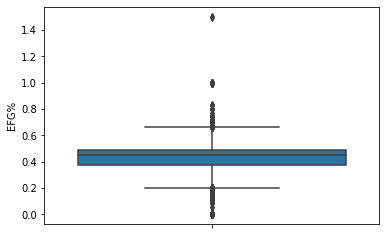

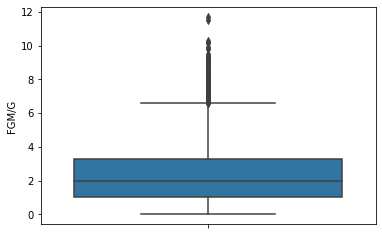

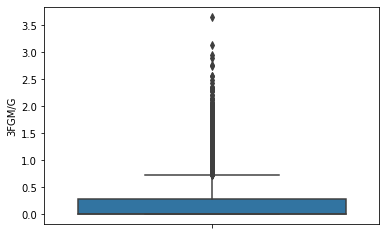

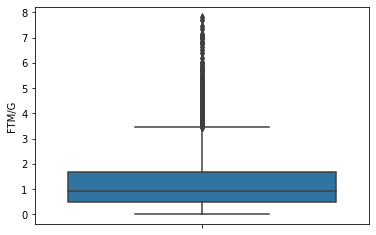

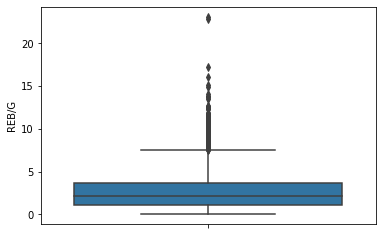

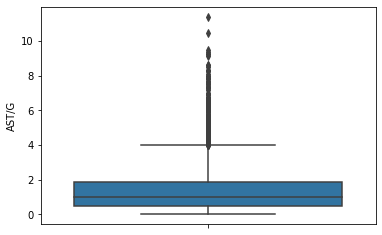

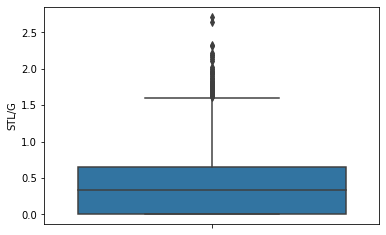

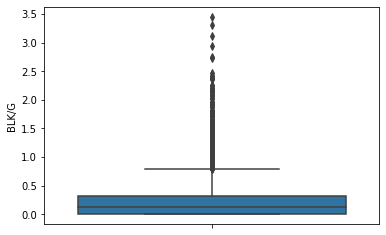

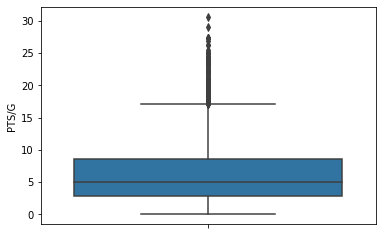

In [ ]:
for i in final_featlist:
  sns.boxplot(data=careers, y=i)
  plt.show()
  #sns.kdeplot(data=careers, x=i, common_norm=False)

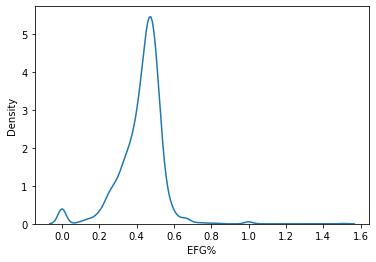

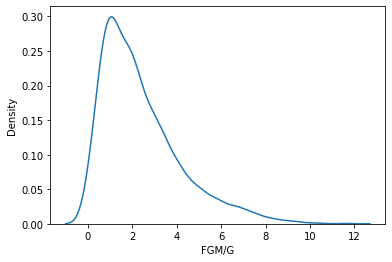

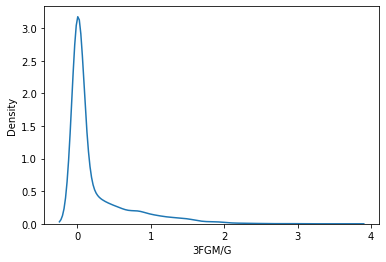

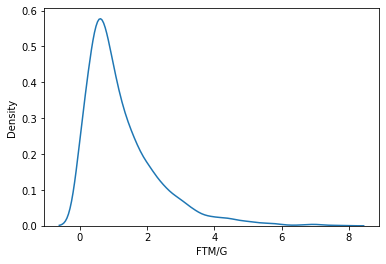

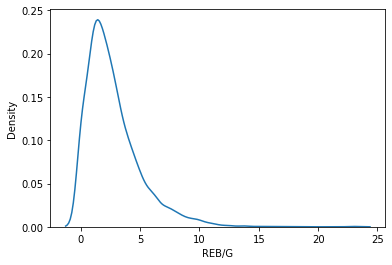

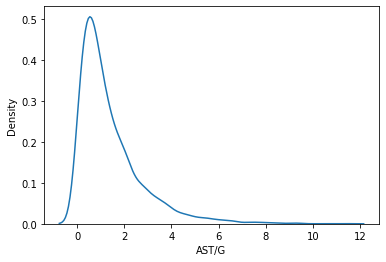

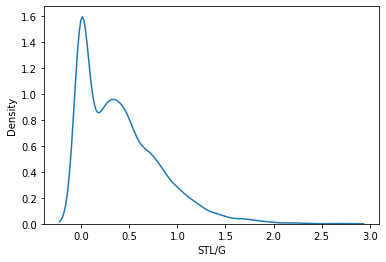

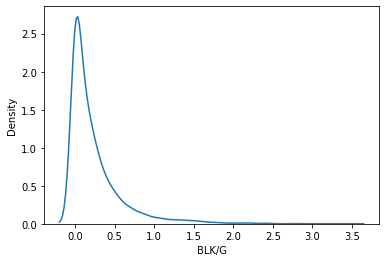

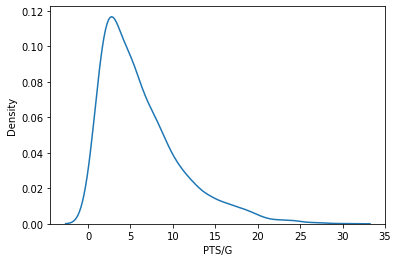

In [ ]:
for i in final_featlist:
  sns.kdeplot(data=careers, x=i, common_norm=False)
  plt.show()

#Potential Bias

The first source of bias in this dataset is that most players do not have great success in the league. Many players get very few opportunities to prove themselves and do not get second chances. There is a large number of players with only a few games or even a few minutes logged in the NBA. The statistics, specifically per-game statistics for these players might skew the data. I'll avoid this by trying to include total statistics in addition to per game statistics in my features to avoid grouping a 'fluke' player with proven superstars.

Another thing to be aware of is that there are a few statistics which weren't collected until a certain year - hopefully this will be balanced out with the other statistics we will include as features.

Since the NBA is a constantly changing league playing a constantly changing game, it will be difficult to compare players of different eras. This is a constant point of contention for fans, and is an issue for my project as well. We can take a look at one example below - looking at how the use of three pointers has drastically changed since its adoption in 1979. How do you compare the eras before and after the three pointer was invented? This is an issue I will run into in my analysis.

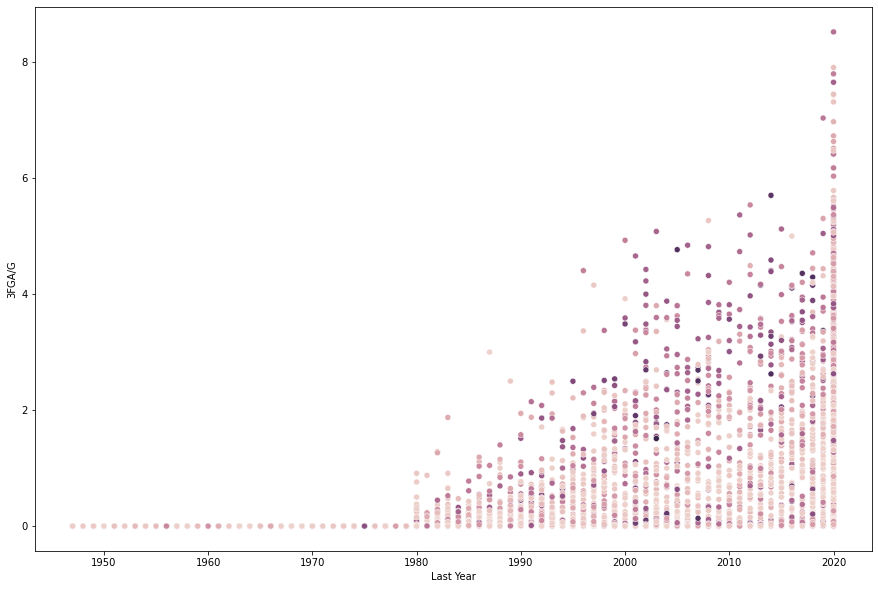

In [ ]:
plt.figure(figsize=(15,10))
sns.scatterplot(x=careers['Last Year'], y=careers['3FGA/G'], hue=careers['G'], legend=False)

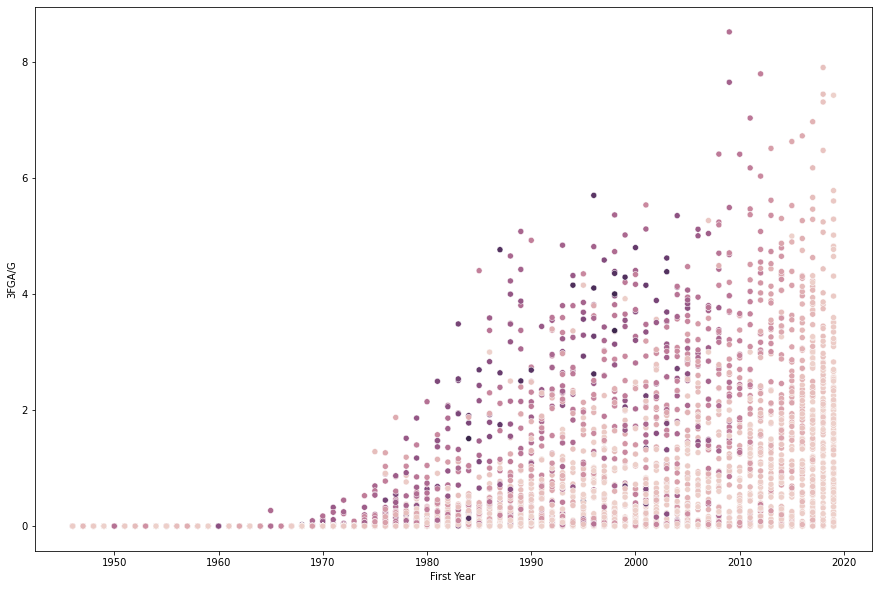

In [ ]:
plt.figure(figsize=(15,10))
sns.scatterplot(x=careers['First Year'], y=careers['3FGA/G'], hue=careers['G'], legend=False)

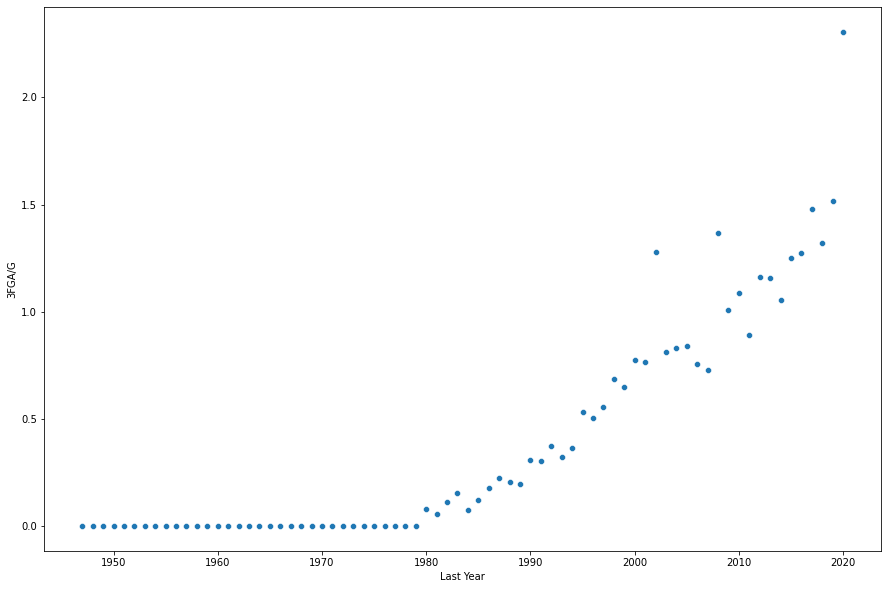

In [ ]:
plt.figure(figsize=(15,10))
sns.scatterplot(x=careers.groupby('Last Year').mean().index, y=careers.groupby('Last Year').mean()['3FGA/G'])

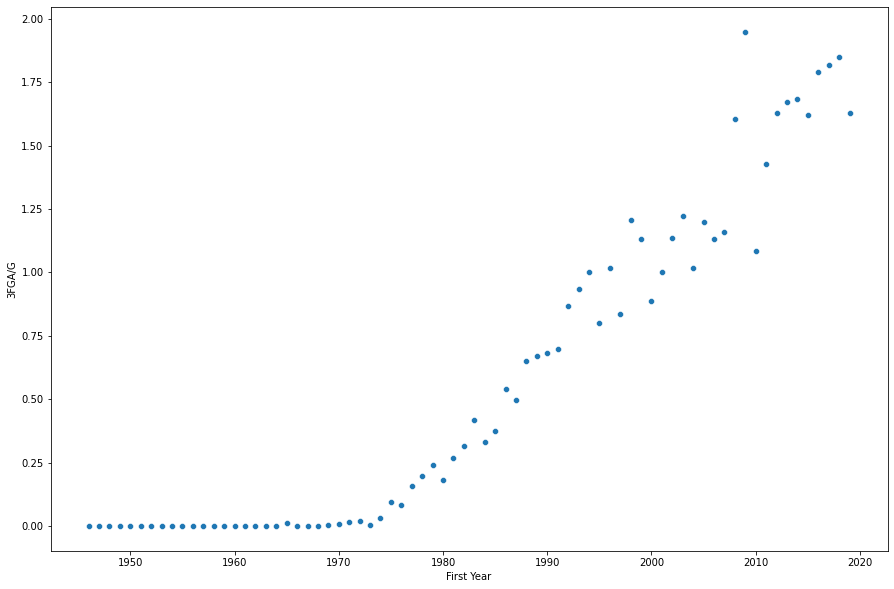

In [ ]:
plt.figure(figsize=(15,10))
sns.scatterplot(x=careers.groupby('First Year').mean().index, y=careers.groupby('First Year').mean()['3FGA/G'])

#Dimensionality Reduction

In [ ]:
X = careers[final_featlist]
scaler = StandardScaler()
X_std = scaler.fit_transform(X)

In [ ]:
pca = PCA(n_components=5)
Principal_components=pca.fit_transform(X_std)
pca_df = pd.DataFrame(data = Principal_components, columns = ['PC 1', 'PC 2', 'PC 3', 'PC 4', 'PC 5'])
print(pca_df)

          PC 1      PC 2      PC 3      PC 4      PC 5
0    -0.515184  0.890039  0.181857  0.614015 -0.266033
1     1.317995  1.593286 -1.074266  0.371360  0.310781
2     7.918530  3.949325 -1.557643 -0.727155  0.515475
3     2.020234 -1.208440 -1.958094  0.814659 -0.971287
4     2.822955 -1.904487  0.132896  0.236242  0.026534
...        ...       ...       ...       ...       ...
4487 -0.146761  1.240498  0.389849  1.043706 -0.496493
4488 -2.727440  0.485807 -0.332663 -1.424067  0.792079
4489 -2.027615 -0.399828 -0.331649  0.101616 -0.263106
4490  0.974762  2.162516  0.233038  0.475547 -0.165645
4491 -1.685827 -0.613036 -1.123687  0.046034  0.265488

[4492 rows x 5 columns]


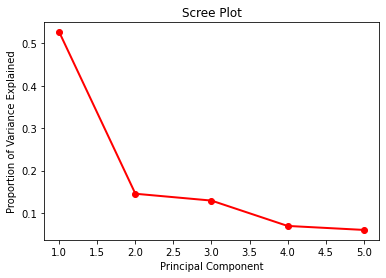

In [ ]:
PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_, 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

In [ ]:
# Computing the first principal components
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_std)

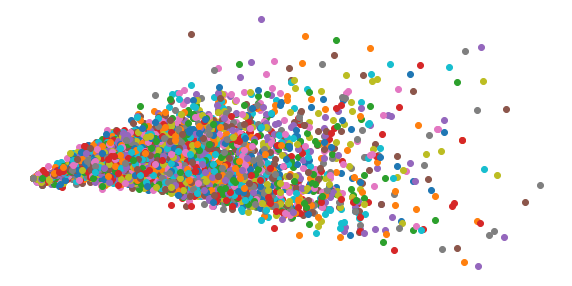

In [ ]:
plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","burlywood","chartreuse"]
for i in range(X_pca.shape[0]):
    plt.scatter(X_pca[i, 0], X_pca[i, 1])

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 4492 samples in 0.016s...
[t-SNE] Computed neighbors for 4492 samples in 0.436s...
[t-SNE] Computed conditional probabilities for sample 1000 / 4492
[t-SNE] Computed conditional probabilities for sample 2000 / 4492
[t-SNE] Computed conditional probabilities for sample 3000 / 4492
[t-SNE] Computed conditional probabilities for sample 4000 / 4492
[t-SNE] Computed conditional probabilities for sample 4492 / 4492
[t-SNE] Mean sigma: 0.446425
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.823425
[t-SNE] KL divergence after 1000 iterations: 1.186867


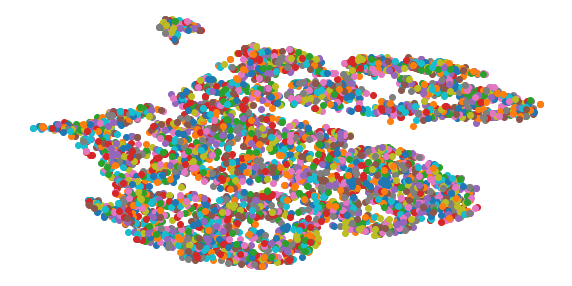

In [ ]:
tsne = TSNE(n_components=2, verbose=1, perplexity=50)
tsne_results = tsne.fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","burlywood","chartreuse"]
for i in range(tsne_results.shape[0]):
    plt.scatter(tsne_results[i, 0], tsne_results[i, 1])

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

t-SNE takes a long time and doesn't end up being useful for our final analysis.

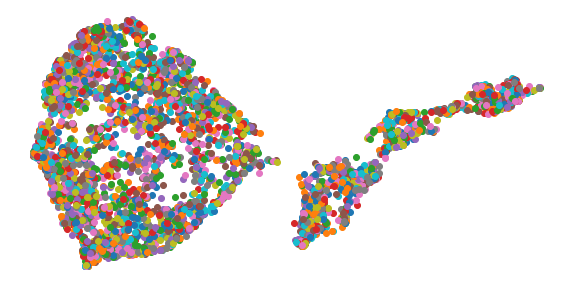

In [ ]:
umap_results = umap.UMAP(n_neighbors=100,
                      min_dist=0.01,
                      metric='correlation').fit_transform(X_std)

plt.figure(figsize=(10,5))
colours = ["r","b","g","c","m","y","k","burlywood","chartreuse"]
for i in range(umap_results.shape[0]):
    plt.scatter(umap_results[i, 0], umap_results[i, 1])

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

#Clustering

##K-Means

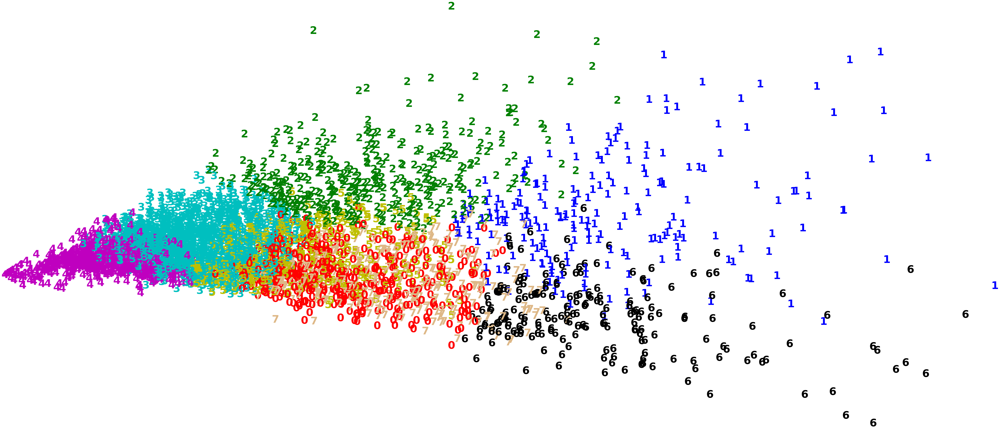

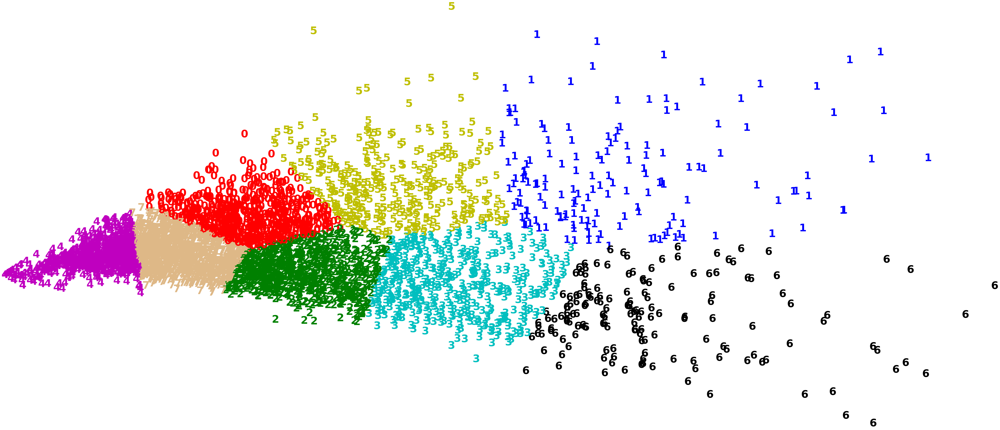

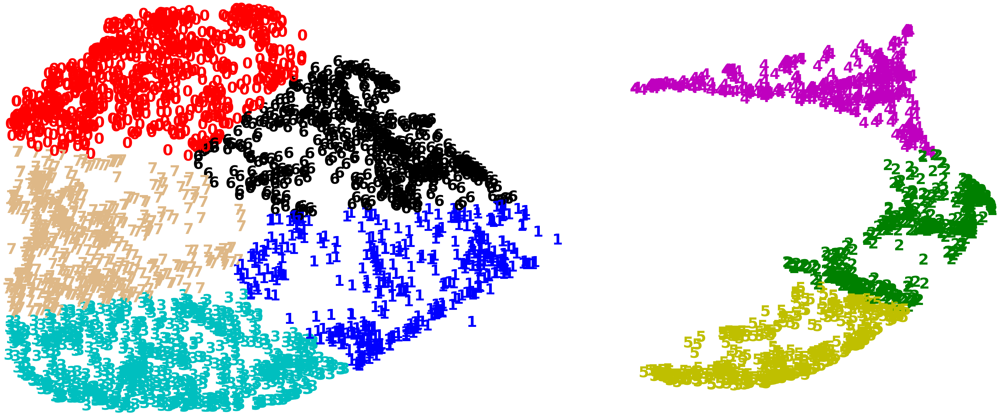

In [ ]:
# Defining the k-means
kmeans_cluster = KMeans(random_state=123)

for i in [X_std, X_pca, tsne_results, umap_results]:
  # Fit model
  kmeans_cluster.fit(i)
  y_pred = kmeans_cluster.predict(i)
  pca = PCA(n_components=2).fit_transform(i)

  plt.figure(figsize=(6,3))
  colours = ["r","b","g","c","m","y","k","burlywood","chartreuse"]
  for j in range(len(y_pred)):
    plt.text(pca[j, 0], pca[j, 1], str(y_pred[j]),
          color=colours[y_pred[j]],
          fontdict={'weight': 'bold', 'size': 50}
        )

  plt.xticks([])
  plt.yticks([])
  plt.axis('off')
  plt.show()

In [ ]:
for i in (X_std, X_pca, tsne_results, umap_results):
  for j in (4,5,6,7,8,9,10):
    labels = KMeans(n_clusters = j,random_state=123).fit_predict(i)
    print('Silhouette score for ',j,' groups: ',metrics.silhouette_score(i, labels, metric='euclidean'))

Silhouette score for  4  groups:  0.20266726744277058
Silhouette score for  5  groups:  0.2001322920700922
Silhouette score for  6  groups:  0.2242175842793903
Silhouette score for  7  groups:  0.2243913985055418
Silhouette score for  8  groups:  0.2345859760517998
Silhouette score for  9  groups:  0.2364426894965323
Silhouette score for  10  groups:  0.2062451867388953
Silhouette score for  4  groups:  0.4068248374113407
Silhouette score for  5  groups:  0.37632066618440285
Silhouette score for  6  groups:  0.37493956961673713
Silhouette score for  7  groups:  0.3806237251898392
Silhouette score for  8  groups:  0.33543727736092344
Silhouette score for  9  groups:  0.3405505258016576
Silhouette score for  10  groups:  0.3439380751748229
Silhouette score for  4  groups:  0.4355159
Silhouette score for  5  groups:  0.45157918
Silhouette score for  6  groups:  0.42895436
Silhouette score for  7  groups:  0.42018226
Silhouette score for  8  groups:  0.41047198
Silhouette score for  9  gro

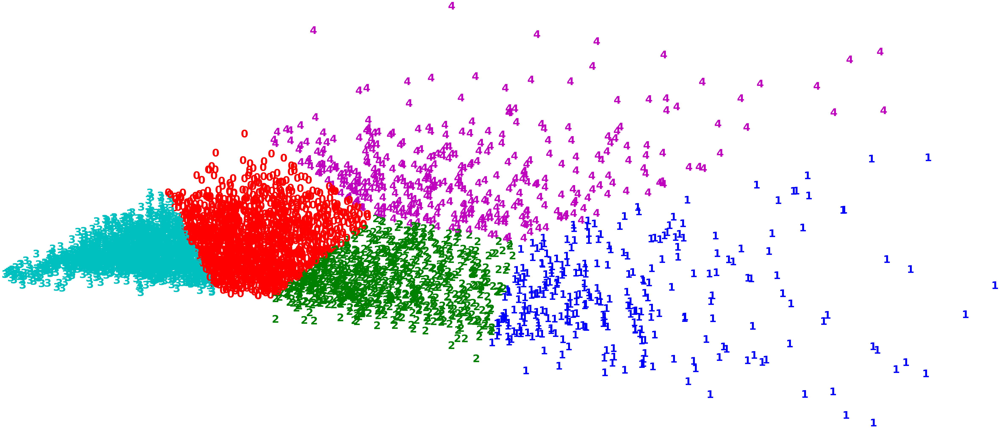

Silhouette score for 5 groups:  0.37632066618440285


In [ ]:
kmeans_cluster = KMeans(n_clusters = 5, random_state=123)

for i in [X_pca]:
  # Fit model
  kmeans_cluster.fit(i)
  y_pred = kmeans_cluster.predict(i)
  pca = PCA(n_components=2).fit_transform(i)

  plt.figure(figsize=(6,3))
  colours = ["r","b","g","c","m","y","k","burlywood","chartreuse"]
  for j in range(len(y_pred)):
    plt.text(pca[j, 0], pca[j, 1], str(y_pred[j]),
          color=colours[y_pred[j]],
          fontdict={'weight': 'bold', 'size': 50}
        )

  plt.xticks([])
  plt.yticks([])
  plt.axis('off')
  plt.show()

  labels = kmeans_cluster.fit_predict(i)
  print('Silhouette score for 5 groups: ',metrics.silhouette_score(i, labels, metric='euclidean'))

In [ ]:
kmeans_cluster = KMeans(n_clusters = 5, random_state=123)

for i in [tsne_results]:
  # Fit model
  kmeans_cluster.fit(i)
  y_pred = kmeans_cluster.predict(i)
  pca = PCA(n_components=2).fit_transform(i)

  plt.figure(figsize=(6,3))
  colours = ["r","b","g","c","m","y","k","burlywood","chartreuse"]
  for j in range(len(y_pred)):
    plt.text(pca[j, 0], pca[j, 1], str(y_pred[j]),
          color=colours[y_pred[j]],
          fontdict={'weight': 'bold', 'size': 50}
        )

  plt.xticks([])
  plt.yticks([])
  plt.axis('off')
  plt.show()

  labels = kmeans_cluster.fit_predict(i)
  print('Silhouette score for 5 groups: ',metrics.silhouette_score(i, labels, metric='euclidean'))

Silhouette score for 5 groups:  0.45157918


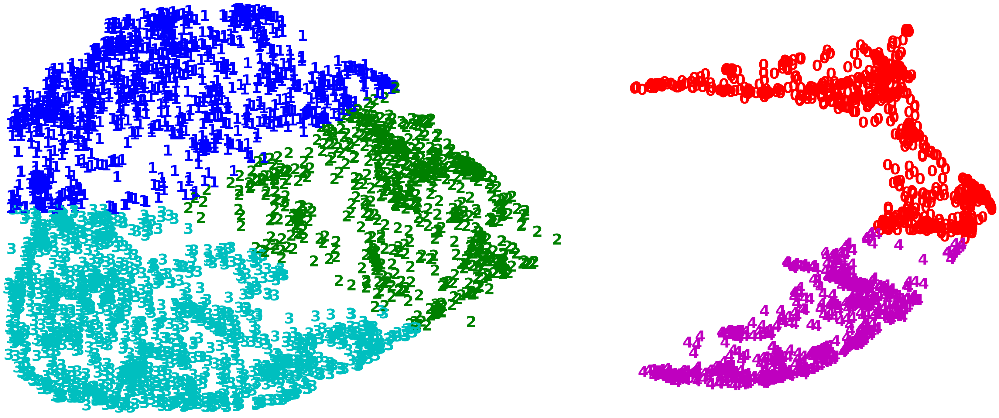

Silhouette score for 5 groups:  0.49270496


In [ ]:
kmeans_cluster = KMeans(n_clusters = 5, random_state=123)

for i in [umap_results]:
  # Fit model
  kmeans_cluster.fit(i)
  y_pred = kmeans_cluster.predict(i)
  pca = PCA(n_components=2).fit_transform(i)

  plt.figure(figsize=(6,3))
  colours = ["r","b","g","c","m","y","k","burlywood","chartreuse"]
  for j in range(len(y_pred)):
    plt.text(pca[j, 0], pca[j, 1], str(y_pred[j]),
          color=colours[y_pred[j]],
          fontdict={'weight': 'bold', 'size': 50}
        )

  plt.xticks([])
  plt.yticks([])
  plt.axis('off')
  plt.show()

  labels = kmeans_cluster.fit_predict(i)
  print('Silhouette score for 5 groups: ',metrics.silhouette_score(i, labels, metric='euclidean'))

##Agglomerative Clustering

In [ ]:
'''for i in [X_std, X_pca, tsne_results, umap_results]:
  for j in ['complete','average','ward']:
    plt.figure(figsize=(10,5))
    print(j)
    dendrogram(linkage(i, method=j))
    plt.show()'''
  

"for i in [X_std, X_pca, tsne_results, umap_results]:\n  for j in ['complete','average','ward']:\n    plt.figure(figsize=(10,5))\n    print(j)\n    dendrogram(linkage(i, method=j))\n    plt.show()"

The dendogram takes way too long

In [ ]:
for i in [tsne_results,umap_results]:
  for j in ['complete','average','ward']:
    for k in [4,5,6,7,8]:
      if j == 'ward':
        agg_cluster = AgglomerativeClustering(n_clusters=k,linkage=j)
      else:
        agg_cluster = AgglomerativeClustering(n_clusters=k,linkage=j, affinity = 'cosine')

      clusters = agg_cluster.fit_predict(i)
      
      print("The silhoutte score of the", j,"Agglomerative Clustering solution for",k,"clusters: {}"
      .format(metrics.silhouette_score(i, clusters, metric='euclidean')))

The silhoutte score of the complete Agglomerative Clustering solution for 4 clusters: 0.37864962220191956
The silhoutte score of the complete Agglomerative Clustering solution for 5 clusters: 0.31949540972709656
The silhoutte score of the complete Agglomerative Clustering solution for 6 clusters: 0.3165309727191925
The silhoutte score of the complete Agglomerative Clustering solution for 7 clusters: 0.29408901929855347
The silhoutte score of the complete Agglomerative Clustering solution for 8 clusters: 0.2764982283115387
The silhoutte score of the average Agglomerative Clustering solution for 4 clusters: 0.42867162823677063
The silhoutte score of the average Agglomerative Clustering solution for 5 clusters: 0.39165356755256653
The silhoutte score of the average Agglomerative Clustering solution for 6 clusters: 0.36713865399360657
The silhoutte score of the average Agglomerative Clustering solution for 7 clusters: 0.3192160427570343
The silhoutte score of the average Agglomerative Clus

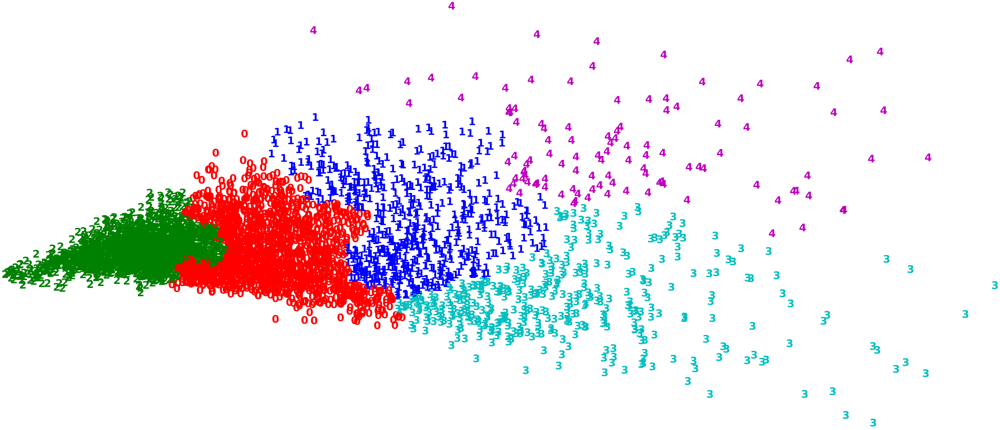

In [ ]:
agg_cluster = AgglomerativeClustering(n_clusters = 5, linkage='ward')
clusters = agg_cluster.fit_predict(X_pca)
pca = PCA(n_components=2).fit_transform(X_pca)

plt.figure(figsize=(6,3))
colours = ["r","b","g","c","m","y","k","burlywood","chartreuse"]
for k in range(len(clusters)):
  plt.text(pca[k, 0], pca[k, 1], str(clusters[k]),
      color=colours[clusters[k]],
      fontdict={'weight': 'bold', 'size': 50}
    )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

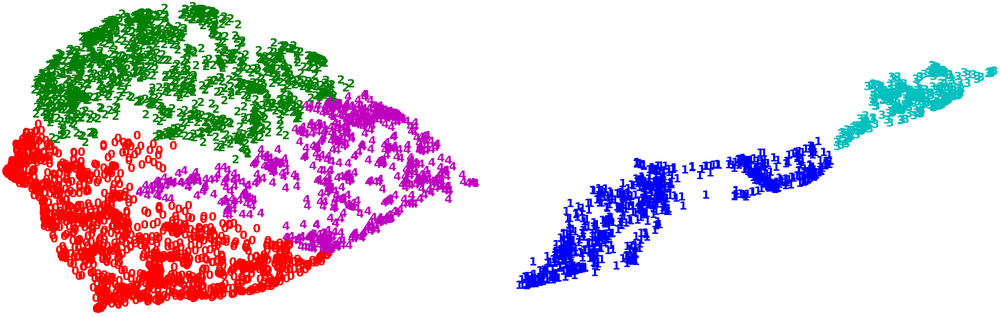

The silhoutte score of the ward Agglomerative Clustering solution: 0.4519925117492676


In [ ]:
for i in ['ward']:
  for j in [umap_results]:
    # Defining the agglomerative clustering
    if i == 'ward':
      agg_cluster = AgglomerativeClustering(n_clusters = 5, linkage=i)
    else:
      agg_cluster = AgglomerativeClustering(linkage=i, affinity = 'cosine')

    # Fit model
    clusters = agg_cluster.fit_predict(j)

    pca = PCA(n_components=2).fit_transform(j)

    plt.figure(figsize=(6,3))
    colours = ["r","b","g","c","m","y","k","burlywood","chartreuse"]
    for k in range(len(clusters)):
      plt.text(pca[k, 0], pca[k, 1], str(clusters[k]),
          color=colours[clusters[k]],
          fontdict={'weight': 'bold', 'size': 50}
        )

    plt.xticks([])
    plt.yticks([])
    plt.axis('off')
    plt.show()

    print("The silhoutte score of the", i,"Agglomerative Clustering solution: {}"
      .format(metrics.silhouette_score(j, clusters, metric='euclidean')))

##DBSCAN

In [ ]:
for i in [X_std, X_pca,tsne_results,umap_results]:
  for j in [0.5,1,1.5,2]:
    for k in [5,10,15]:
      try:
        dbscan_cluster = DBSCAN(eps=j, min_samples=k)

        clusters = dbscan_cluster.fit_predict(i)
      
        print("The silhoutte score of the DBSCAN solution for clusters: {}"
          .format(metrics.silhouette_score(i, clusters, metric='euclidean')))
        print(j,k)
      except:
        print('not working', j, k)

The silhoutte score of the DBSCAN solution for clusters: -0.24050468542470949
0.5 5
The silhoutte score of the DBSCAN solution for clusters: -0.25366508684508293
0.5 10
The silhoutte score of the DBSCAN solution for clusters: -0.19770584591142149
0.5 15
The silhoutte score of the DBSCAN solution for clusters: 0.11490605389826804
1 5
The silhoutte score of the DBSCAN solution for clusters: 0.28818737966703056
1 10
The silhoutte score of the DBSCAN solution for clusters: 0.2737980474745845
1 15
The silhoutte score of the DBSCAN solution for clusters: 0.42764364597074966
1.5 5
The silhoutte score of the DBSCAN solution for clusters: 0.5003721161814696
1.5 10
The silhoutte score of the DBSCAN solution for clusters: 0.4927243053188135
1.5 15
The silhoutte score of the DBSCAN solution for clusters: 0.568454108854638
2 5
The silhoutte score of the DBSCAN solution for clusters: 0.5608210260058275
2 10
The silhoutte score of the DBSCAN solution for clusters: 0.5551884972845179
2 15
The silhoutt

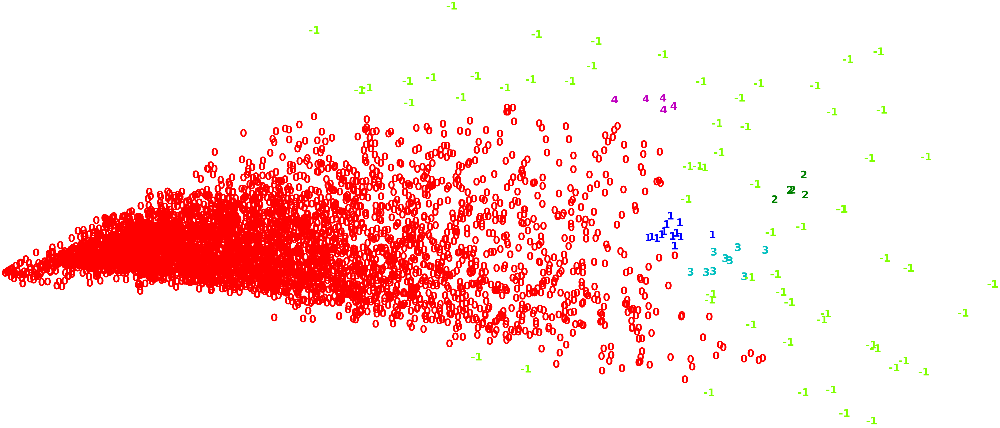

The silhoutte score of the DBSCAN Clustering solution: 0.4693906826566953
0.5 5


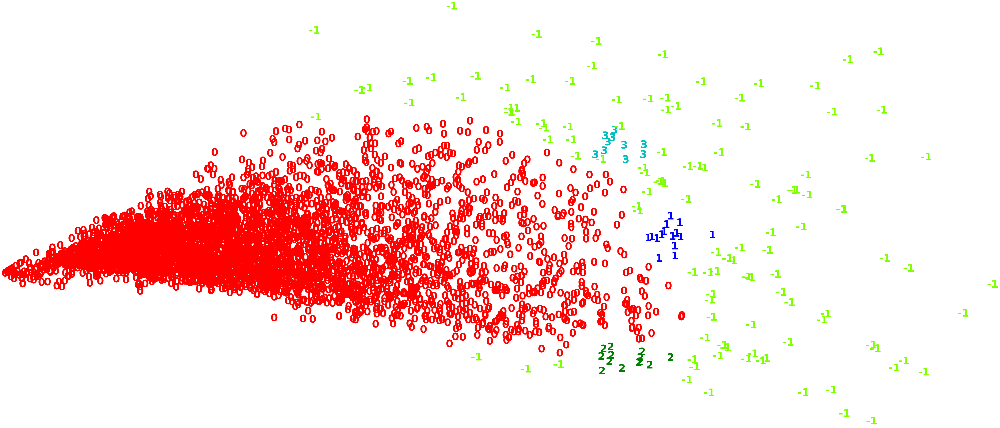

The silhoutte score of the DBSCAN Clustering solution: 0.4494348431172352
0.5 10


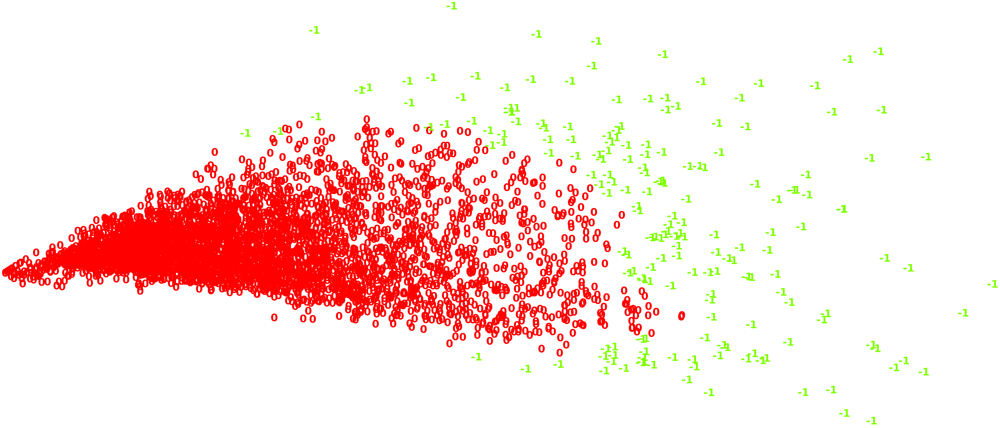

The silhoutte score of the DBSCAN Clustering solution: 0.5810786858212101
0.5 15


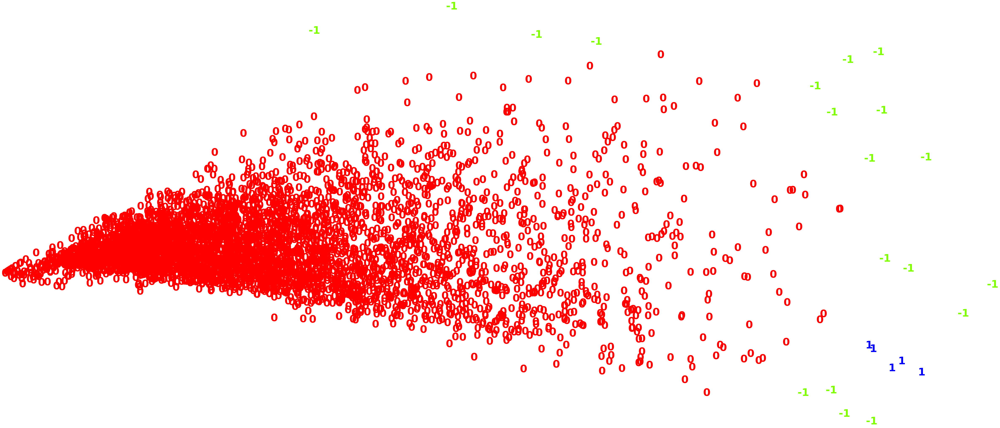

The silhoutte score of the DBSCAN Clustering solution: 0.6466018948057636
1 5


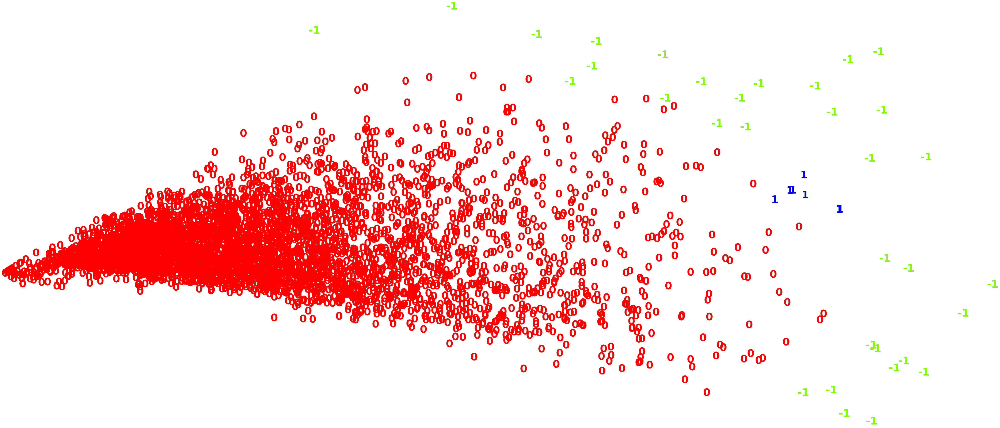

The silhoutte score of the DBSCAN Clustering solution: 0.599546281463231
1 10


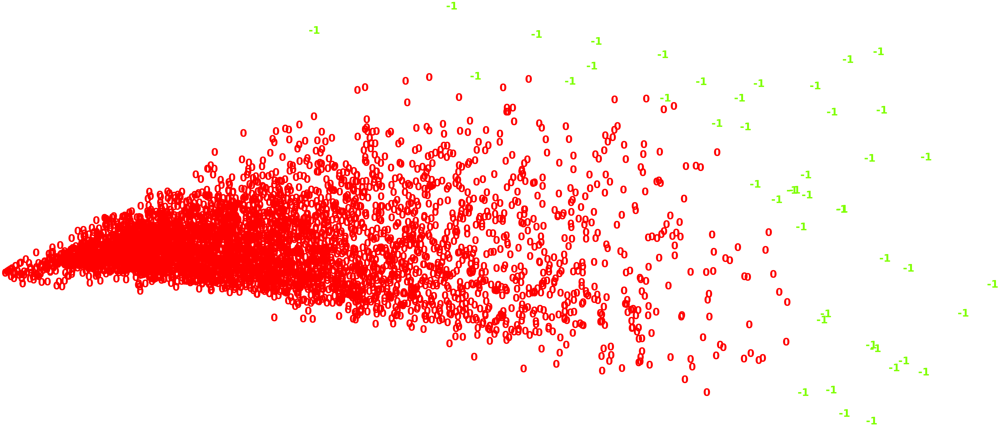

The silhoutte score of the DBSCAN Clustering solution: 0.6450272004773328
1 15


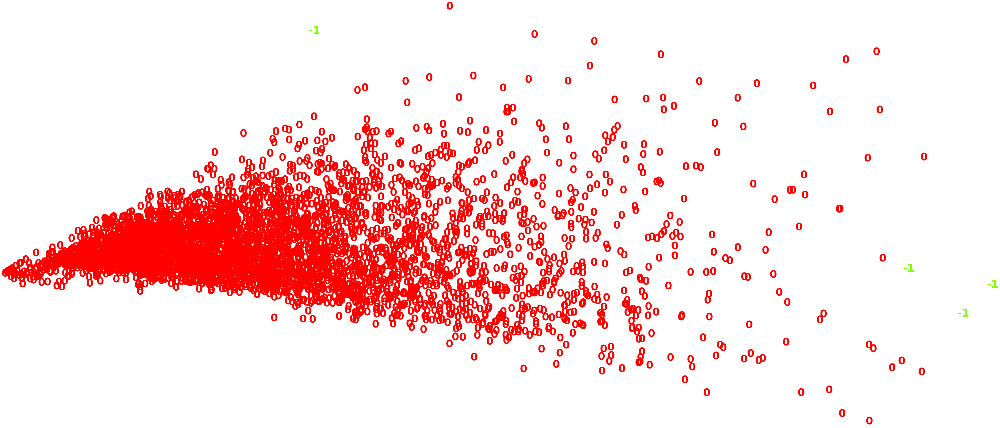

The silhoutte score of the DBSCAN Clustering solution: 0.6608883163213882
1.5 5


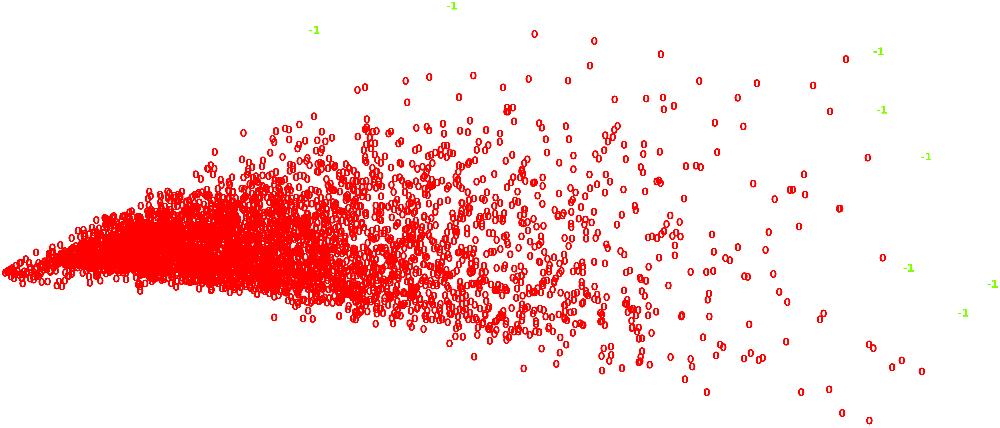

The silhoutte score of the DBSCAN Clustering solution: 0.6685508350975052
1.5 10


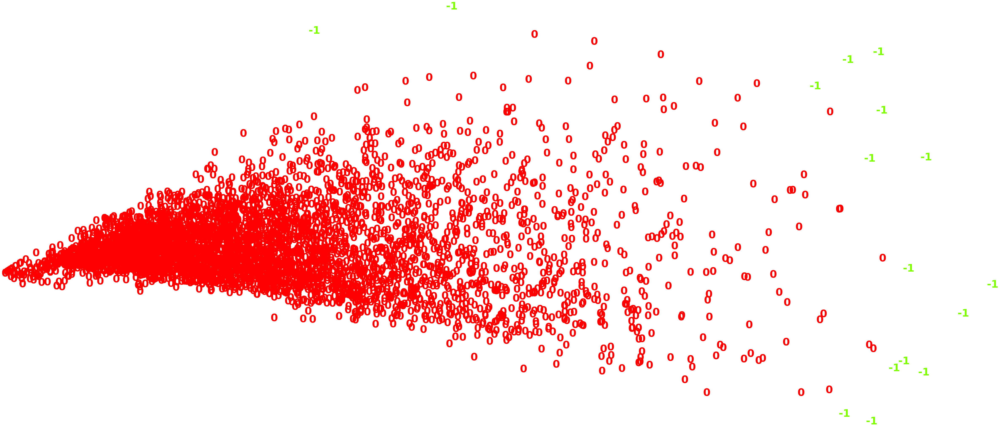

The silhoutte score of the DBSCAN Clustering solution: 0.6749989668856727
1.5 15


In [ ]:
for j in [0.5,1,1.5]:
  for k in [5,10,15]:
    dbscan_cluster = DBSCAN(eps=j,min_samples=k)

    clusters = dbscan_cluster.fit_predict(X_pca)

    pca = PCA(n_components=2).fit_transform(X_pca)

    plt.figure(figsize=(6,3))
    colours = ["r","b","g","c","m","y","k","burlywood","chartreuse"]
    for l in range(len(clusters)):
        plt.text(pca[l, 0], pca[l, 1], str(clusters[l]),
            color=colours[clusters[l]],
            fontdict={'weight': 'bold', 'size': 50}
          )

    plt.xticks([])
    plt.yticks([])
    plt.axis('off')
    plt.show()

    print("The silhoutte score of the DBSCAN Clustering solution: {}"
        .format(metrics.silhouette_score(X_pca, clusters, metric='euclidean')))
    print(j,k)

These were the best performing DBSCAN results for X_pca - as we can see it just groups everything together. With DBSCAN we also can't specify how many clusters we want.

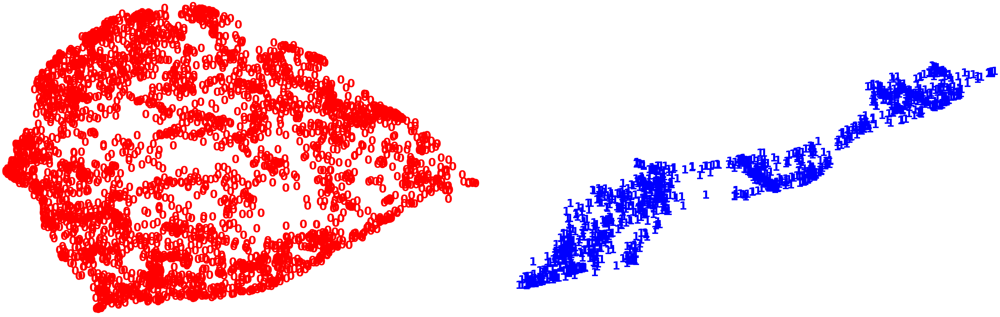

The silhoutte score of the DBSCAN Clustering solution: 0.5607524514198303


In [ ]:
dbscan_cluster = DBSCAN()

clusters = dbscan_cluster.fit_predict(umap_results)

pca = PCA(n_components=2).fit_transform(umap_results)

plt.figure(figsize=(6,3))
colours = ["r","b","g","c","m","y","k","burlywood","chartreuse"]
for l in range(len(clusters)):
    plt.text(pca[l, 0], pca[l, 1], str(clusters[l]),
        color=colours[clusters[l]],
        fontdict={'weight': 'bold', 'size': 50}
      )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

print("The silhoutte score of the DBSCAN Clustering solution: {}"
    .format(metrics.silhouette_score(umap_results, clusters, metric='euclidean')))

With UMAP, not all of these clusters are very linearly seperable, and we can see that DBSCAN won't perform very well.

##GMM

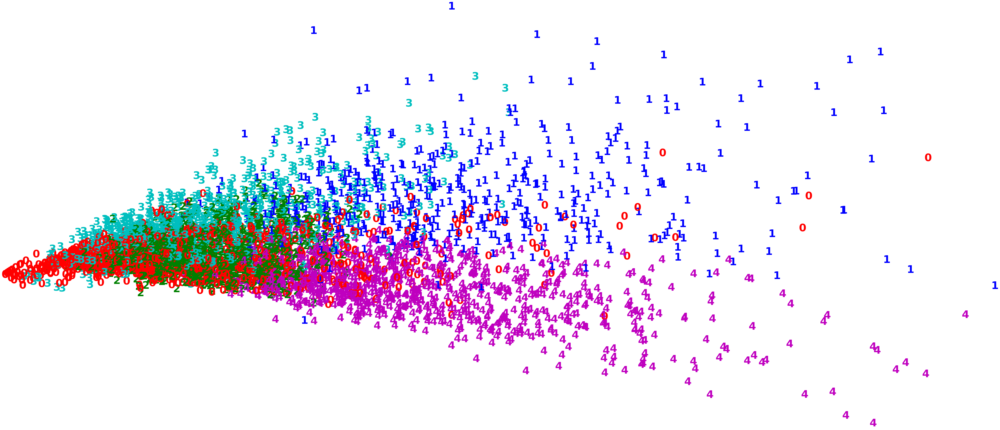

The silhoutte score of the GMM Clustering solution: 0.08494111895561218


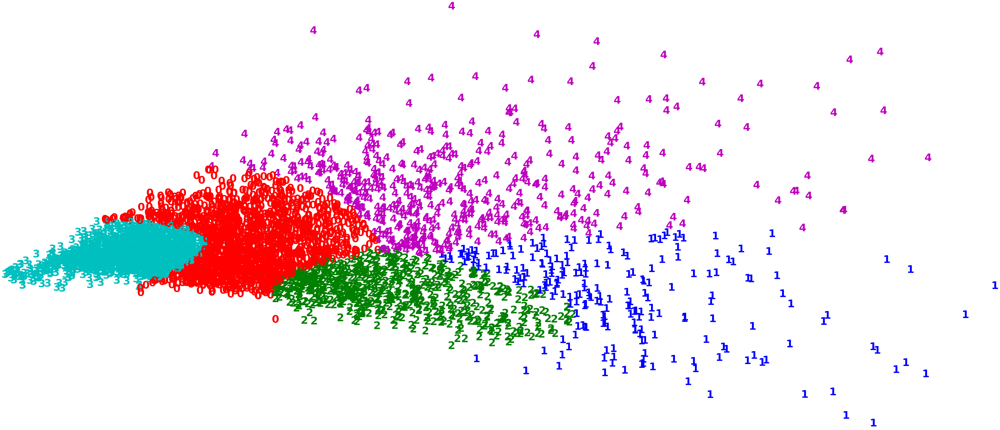

The silhoutte score of the GMM Clustering solution: -0.11306808888912201


The silhoutte score of the GMM Clustering solution: 0.15637479722499847


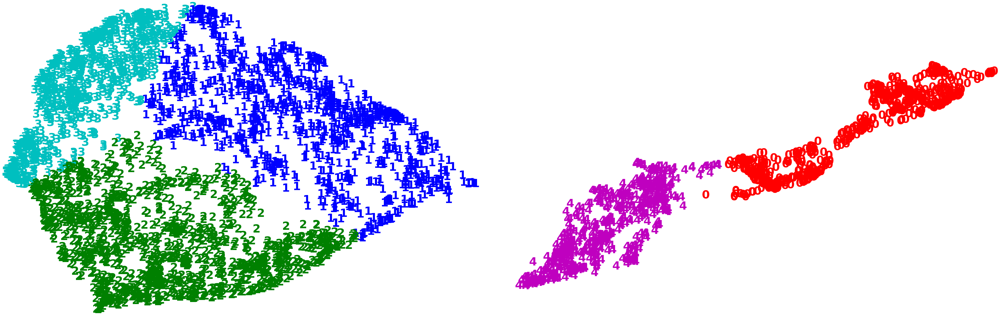

The silhoutte score of the GMM Clustering solution: 0.448095440864563


In [ ]:
for i in [X_std, X_pca, tsne_results, umap_results]:
  gmm_cluster = GaussianMixture(n_components=5, random_state=123)

  clusters = gmm_cluster.fit_predict(i)

  pca = PCA(n_components=2).fit_transform(i)

  plt.figure(figsize=(6,3))
  colours = ["r","b","g","c","m","y","k","burlywood","chartreuse"]
  for l in range(len(clusters)):
    plt.text(pca[l, 0], pca[l, 1], str(clusters[l]),
      color=colours[clusters[l]],
      fontdict={'weight': 'bold', 'size': 50}
      )

  plt.xticks([])
  plt.yticks([])
  plt.axis('off')
  plt.show()

  print("The silhoutte score of the GMM Clustering solution: {}"
    .format(metrics.silhouette_score(umap_results, clusters, metric='euclidean')))

#Evaluating Final Clusters

In [ ]:
final_gmm = X.copy()
final_gmm['Clusters'] = GaussianMixture(n_components=5, random_state=123).fit_predict(X_pca)

In [ ]:
final_gmm.groupby('Clusters').mean()

,EFG%,FGM/G,3FGM/G,FTM/G,REB/G,AST/G,STL/G,BLK/G,PTS/G
Clusters,,,,,,,,,
0,0.451660,2.061635,0.167404,1.070072,2.635855,1.120011,0.344784,0.221659,5.360746
1,0.488145,6.450853,0.887116,3.620426,4.811935,4.219058,1.094888,0.352020,17.409247
2,0.469737,3.620041,0.693690,1.747768,2.584286,2.973795,0.778248,0.157967,9.681540
3,0.344288,0.882852,0.058233,0.486259,1.082025,0.520108,0.137334,0.059396,2.310195
4,0.495711,4.375717,0.133709,2.285198,6.841179,1.594217,0.631021,0.869400,11.170342


In [ ]:
final_gmm.groupby('Clusters').count()

,EFG%,FGM/G,3FGM/G,FTM/G,REB/G,AST/G,STL/G,BLK/G,PTS/G
Clusters,,,,,,,,,
0,1581,1581,1581,1581,1581,1581,1581,1581,1581
1,226,226,226,226,226,226,226,226,226
2,658,658,658,658,658,658,658,658,658
3,1495,1495,1495,1495,1495,1495,1495,1495,1495
4,532,532,532,532,532,532,532,532,532


In [ ]:
careers['clusters'] = final_gmm['Clusters']

In [ ]:
final_featlist

['EFG%',
 'FGM/G',
 '3FGM/G',
 'FTM/G',
 'REB/G',
 'AST/G',
 'STL/G',
 'BLK/G',
 'PTS/G']

In [ ]:
careers[careers['Full Name']=='Nikola Jokic']

,Full Name,Position,G,MIN,TS%,EFG%,FGM,FGA,FG%,3FGM,3FGA,3FG%,FTM,FTA,FT%,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Position: Guard,Position: Forward,Position: Center,MIN/G,FGM/G,FGA/G,3FGM/G,3FGA/G,FTM/G,FTA/G,OFF/G,DEF/G,REB/G,AST/G,STL/G,BLK/G,TO/G,PF/G,PTS/G,First Year,Last Year,Years Active,P*A,P*R,A*R,P*R*A,clusters
2050,Nikola Jokic,C,414.0,12305.0,0.603979,0.561343,2796.0,5347.0,0.52291,411.0,1182.0,0.347716,1275.0,1541.0,0.827385,1073.0,2950.0,4023.0,2324.0,458.0,293.0,1057.0,1206.0,7278.0,0.0,0.0,1.0,29.722222,6.753623,12.915459,0.992754,2.855072,3.07971,3.722222,2.591787,7.125604,9.717391,5.613527,1.10628,0.707729,2.55314,2.913043,17.57971,2015.0,2020.0,5.0,98.68417,170.828922,54.548834,958.952695,1


In [ ]:
 careers.groupby('clusters').mean()

,G,MIN,TS%,EFG%,FGM,FGA,FG%,3FGM,3FGA,3FG%,FTM,FTA,FT%,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Position: Guard,Position: Forward,Position: Center,MIN/G,FGM/G,FGA/G,3FGM/G,3FGA/G,FTM/G,FTA/G,OFF/G,DEF/G,REB/G,AST/G,STL/G,BLK/G,TO/G,PF/G,PTS/G,First Year,Last Year,Years Active,P*A,P*R,A*R,P*R*A
clusters,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,229.209361,3728.949399,0.490632,0.451660,535.887413,1250.672992,0.432371,38.461733,113.765971,0.147312,272.466161,385.585073,0.681902,176.871600,367.130930,749.197976,269.597090,86.521822,56.812777,144.215054,472.275775,1382.702720,0.407337,0.580645,0.263125,13.633194,2.061635,4.990669,0.167404,0.519392,1.070072,1.543296,0.649197,1.348618,2.635855,1.120011,0.344784,0.221659,0.589845,1.849652,5.360746,1987.781784,1992.490829,4.709045,6.427204,14.984242,2.755423,16.896783
1,799.610619,26299.128319,0.538786,0.488145,5235.823009,11467.446903,0.455116,667.805310,1888.676991,0.283776,2992.265487,3733.495575,0.792744,817.460177,2451.327434,3844.849558,3518.146018,900.495575,277.473451,1562.238938,1973.084071,14131.716814,0.703540,0.522124,0.035398,32.222986,6.450853,14.159691,0.887116,2.516068,3.620426,4.551109,1.016631,3.119083,4.811935,4.219058,1.094888,0.352020,1.947545,2.452787,17.409247,1991.823009,2003.044248,11.221239,74.606309,85.387528,19.927788,361.032874
2,520.500000,12778.595745,0.512791,0.469737,2001.009119,4611.870821,0.425881,363.802432,1009.123100,0.272690,960.296353,1216.256839,0.778356,281.890578,946.469605,1416.492401,1673.410334,430.621581,85.299392,656.870821,1085.179331,5326.117021,0.878419,0.259878,0.015198,22.870491,3.620041,8.526425,0.693690,1.944320,1.747768,2.240775,0.506081,1.739364,2.584286,2.973795,0.778248,0.157967,1.189026,2.068788,9.681540,1992.364742,2000.466565,8.101824,29.236232,25.837447,7.660146,77.774840
3,43.360535,325.408696,0.387879,0.344288,49.730435,138.204682,0.331554,2.907023,10.206689,0.088487,26.083612,40.121070,0.568363,13.066890,24.713043,59.642140,27.465552,7.264214,3.390635,12.405351,56.151839,128.451505,0.452843,0.511706,0.173244,6.102001,0.882852,2.623957,0.058233,0.237829,0.486259,0.766743,0.244023,0.466544,1.082025,0.520108,0.137334,0.059396,0.265529,1.057464,2.310195,1982.755184,1984.660201,1.905017,1.396443,2.759267,0.585657,1.657323
4,690.005639,18700.129699,0.535628,0.495711,3190.208647,6588.738722,0.488304,82.819549,258.887218,0.157545,1699.456767,2378.808271,0.702851,1287.221805,2807.281955,5023.966165,1184.488722,449.778195,619.483083,929.060150,1941.890977,8162.693609,0.077068,0.736842,0.603383,25.779335,4.375717,9.055291,0.133709,0.415549,2.285198,3.208030,1.787816,3.854790,6.841179,1.594217,0.631021,0.869400,1.281470,2.767153,11.170342,1988.881579,1999.101504,10.219925,20.166221,83.072345,12.007723,165.285478


In [ ]:
ss = ['PTS/G','REB/G','AST/G','FG%','3FG%','FT%','G','MIN/G','Years Active']

In [ ]:
for i in ss:
  print(careers.groupby('clusters').mean()[i])

clusters
0     5.391980
1    17.409247
2     9.681540
3     2.452634
4    11.170342
Name: PTS/G, dtype: float64
clusters
0    2.655728
1    4.811935
2    2.584286
3    1.122127
4    6.841179
Name: REB/G, dtype: float64
clusters
0    1.129462
1    4.219058
2    2.973795
3    0.542982
4    1.594217
Name: AST/G, dtype: float64
clusters
0    0.426934
1    0.455116
2    0.425881
3    0.354559
4    0.488304
Name: FG%, dtype: float64
clusters
0    0.147446
1    0.283776
2    0.272690
3    0.094626
4    0.157545
Name: 3FG%, dtype: float64
clusters
0    0.687476
1    0.792744
2    0.778356
3    0.593716
4    0.702851
Name: FT%, dtype: float64
clusters
0    231.388889
1    799.610619
2    520.500000
3     46.175966
4    690.005639
Name: G, dtype: float64
clusters
0    13.734991
1    32.222986
2    22.870491
3     6.330474
4    25.779335
Name: MIN/G, dtype: float64
clusters
0     4.744572
1    11.221239
2     8.101824
3     1.960658
4    10.219925
Name: Years Active, dtype: float64


In [ ]:
careers.groupby('clusters').count()/careers.shape[0]

,Full Name,Position,G,MIN,TS%,EFG%,FGM,FGA,FG%,3FGM,3FGA,3FG%,FTM,FTA,FT%,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Position: Guard,Position: Forward,Position: Center,MIN/G,FGM/G,FGA/G,3FGM/G,3FGA/G,FTM/G,FTA/G,OFF/G,DEF/G,REB/G,AST/G,STL/G,BLK/G,TO/G,PF/G,PTS/G,First Year,Last Year,Years Active,P*A,P*R,A*R,P*R*A
clusters,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534,0.357534
1,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598,0.051598
2,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228,0.150228
3,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178,0.319178
4,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461,0.121461


In [ ]:
extremes = careers[careers['EFG%'] >= 1]
extremes = pd.concat([extremes,careers[careers['EFG%']<=0]])

In [ ]:
for i in extremes.index:
  careers = careers.drop(i)

In [ ]:
group_0 = careers[careers['clusters']==0]
group_1 = careers[careers['clusters']==1]
group_2 = careers[careers['clusters']==2]
group_3 = careers[careers['clusters']==3]
group_4 = careers[careers['clusters']==4]

In [ ]:
careers['PTS'].max()

44149.0

In [ ]:
careers.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4380 entries, 0 to 4491
Data columns (total 51 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Full Name          4380 non-null   object 
 1   Position           4380 non-null   object 
 2   G                  4380 non-null   float64
 3   MIN                4380 non-null   float64
 4   TS%                4380 non-null   float64
 5   EFG%               4380 non-null   float64
 6   FGM                4380 non-null   float64
 7   FGA                4380 non-null   float64
 8   FG%                4380 non-null   float64
 9   3FGM               4380 non-null   float64
 10  3FGA               4380 non-null   float64
 11  3FG%               4380 non-null   float64
 12  FTM                4380 non-null   float64
 13  FTA                4380 non-null   float64
 14  FT%                4380 non-null   float64
 15  OFF                4380 non-null   float64
 16  DEF                4380 

(0.0, 3.0)

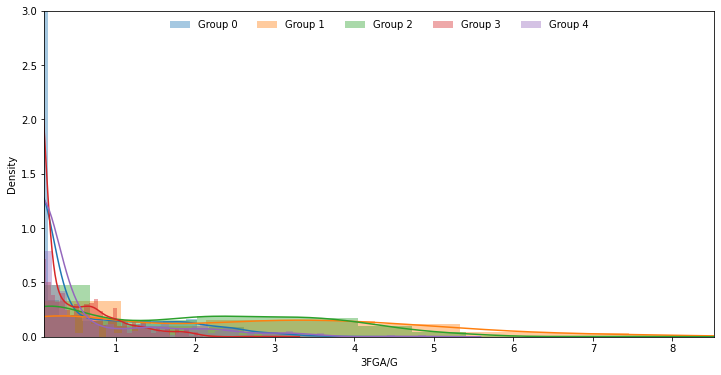

In [ ]:
plt.figure(figsize=(12,6))
sns.distplot(group_0['3FGA/G'], hist=True, label='Group 0')
sns.distplot(group_1['3FGA/G'], hist=True, label='Group 1')
sns.distplot(group_2['3FGA/G'], hist=True, label='Group 2')
sns.distplot(group_3['3FGA/G'], hist=True, label='Group 3')
sns.distplot(group_4['3FGA/G'], hist=True, label='Group 4')
plt.legend(framealpha=1, frameon=False, loc='upper center', ncol=5)
plt.xlim([0.1,careers['3FGA/G'].max()])
plt.ylim([0,3])

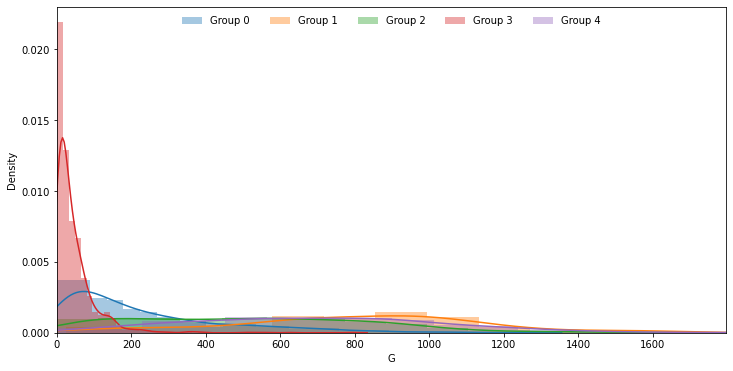

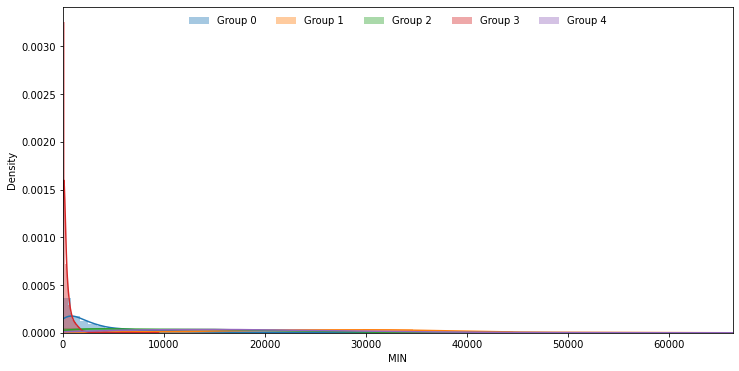

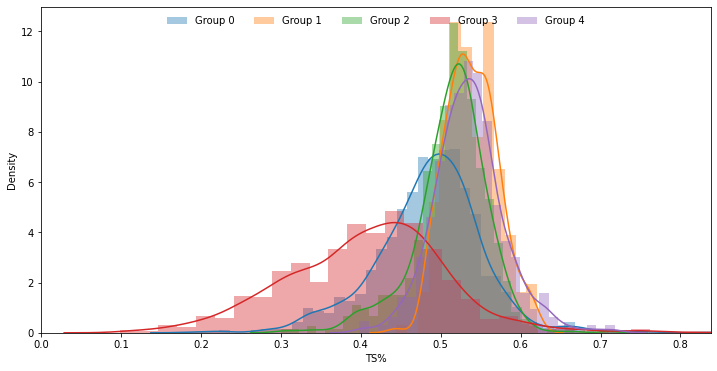

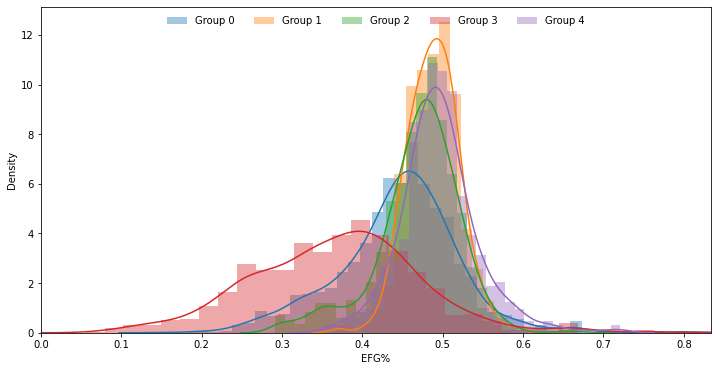

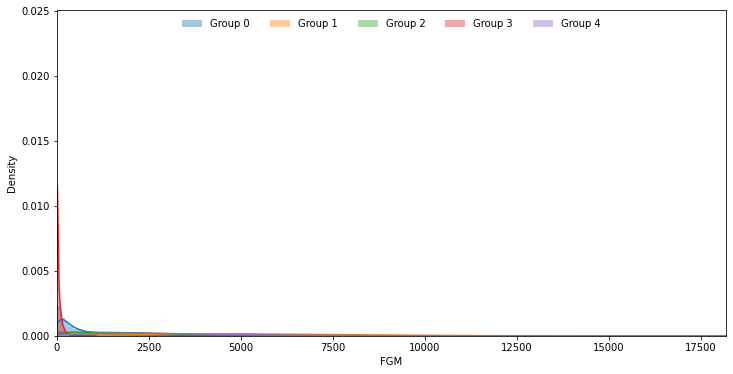

...

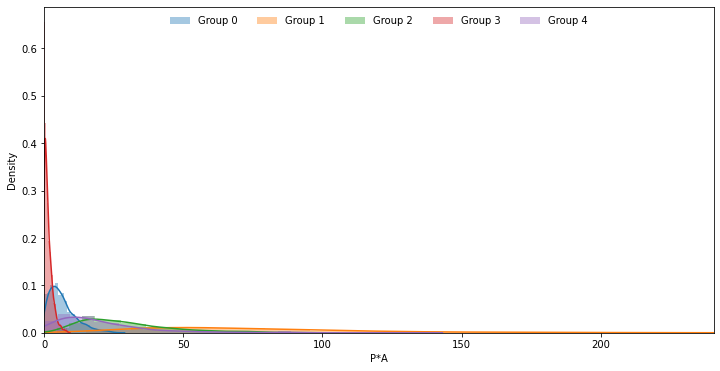

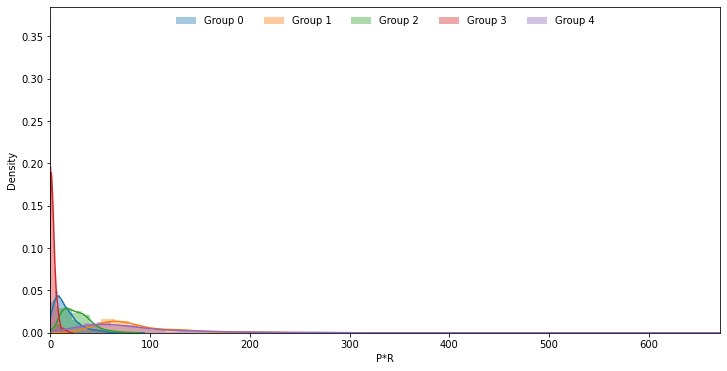

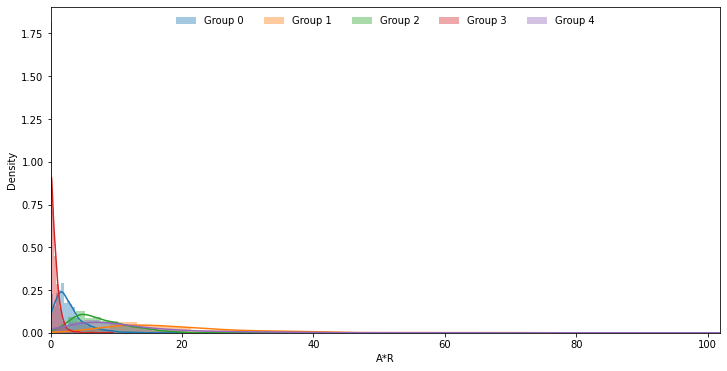

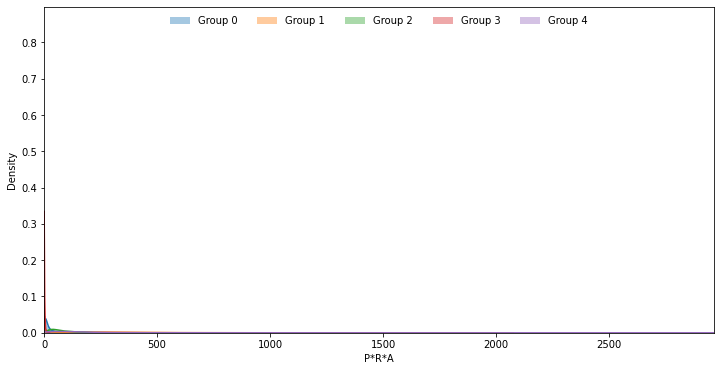

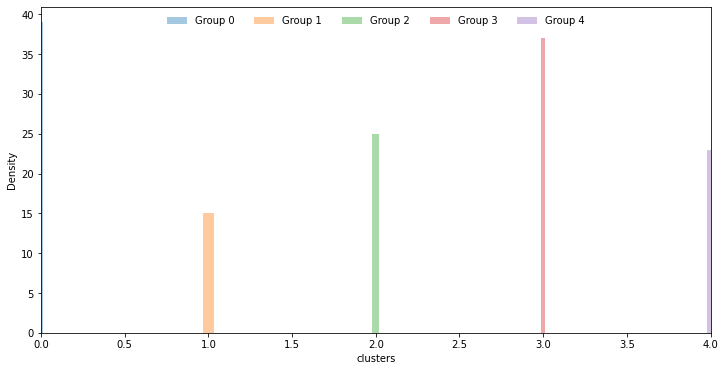

In [ ]:
for i in careers.columns[2:]:
#if i == '3FGM/G' or i == 'BLK/G':
    #plt.figure(figsize=(12,6))
    #sns.distplot(group_0[i], hist=True, label='Group 0')
    #sns.distplot(group_1[i], hist=True, label='Group 1')
    #sns.distplot(group_2[i], hist=True, label='Group 2')
    #sns.distplot(group_3[i], hist=True, label='Group 3')
    #sns.distplot(group_4[i], hist=True, label='Group 4')
    #plt.legend(framealpha=1, frameon=False, loc='upper center', ncol=5)
    #plt.xlim([.01, 0.5])
  plt.figure(figsize=(12,6))
  sns.distplot(group_0[i], hist=True, label='Group 0')
  sns.distplot(group_1[i], hist=True, label='Group 1')
  sns.distplot(group_2[i], hist=True, label='Group 2')
  sns.distplot(group_3[i], hist=True, label='Group 3')
  sns.distplot(group_4[i], hist=True, label='Group 4')
  plt.legend(framealpha=1, frameon=False, loc='upper center', ncol=5)
  plt.xlim([0,careers[i].max()])

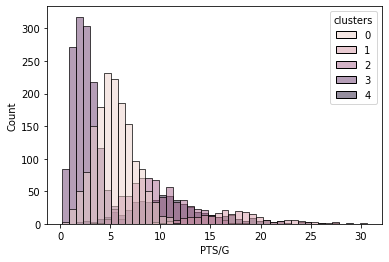

In [ ]:
#for i in final_featlist:
sns.histplot(x = careers['PTS/G'], color="red", hue=careers['clusters'])
plt.show()

In [ ]:
careers[careers['clusters']==4].sort_values('PTS/G', ascending=False).head(50)

,Full Name,Position,G,MIN,TS%,EFG%,FGM,FGA,FG%,3FGM,3FGA,3FG%,FTM,FTA,FT%,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Position: Guard,Position: Forward,Position: Center,MIN/G,FGM/G,FGA/G,3FGM/G,3FGA/G,FTM/G,FTA/G,OFF/G,DEF/G,REB/G,AST/G,STL/G,BLK/G,TO/G,PF/G,PTS/G,First Year,Last Year,Years Active,P*A,P*R,A*R,P*R*A,clusters
675,Wilt Chamberlain,C,1205.0,55418.0,0.544556,0.537884,14106.0,26225.0,0.537884,0.0,0.0,0.000000,6814.0,13489.0,0.505152,0.0,0.0,27837.0,5316.0,0.0,0.0,0.0,2487.0,35026.0,0.0,0.0,1.0,45.990041,11.706224,21.763485,0.000000,0.000000,5.654772,11.194191,0.000000,0.000000,23.101245,4.411618,0.000000,0.000000,0.000000,2.063900,29.067220,1959.0,1973.0,14.0,128.233478,671.488963,101.913873,2962.352970,4
248,Elgin Baylor,F,980.0,39373.0,0.494524,0.432068,10081.0,23332.0,0.432068,0.0,0.0,0.000000,6610.0,8492.0,0.778380,0.0,0.0,13187.0,4191.0,0.0,0.0,0.0,3031.0,26772.0,0.0,1.0,0.0,40.176531,10.286735,23.808163,0.000000,0.000000,6.744898,8.665306,0.000000,0.000000,13.456122,4.276531,0.000000,0.000000,0.000000,3.092857,27.318367,1958.0,1972.0,14.0,116.827834,367.599296,57.545520,1572.049643,4
3160,Bob Pettit,F-C,880.0,34235.0,0.509679,0.433818,8115.0,18706.0,0.433818,0.0,0.0,0.000000,6890.0,9034.0,0.762674,0.0,0.0,14153.0,2610.0,0.0,0.0,0.0,2806.0,23120.0,0.0,1.0,1.0,38.903409,9.221591,21.256818,0.000000,0.000000,7.829545,10.265909,0.000000,0.000000,16.082955,2.965909,0.000000,0.000000,0.000000,3.188636,26.272727,1954.0,1965.0,11.0,77.922521,422.543079,47.700581,1253.224358,4
2483,Karl Malone,F,1669.0,62759.0,0.570461,0.510925,15271.0,29978.0,0.509407,91.0,347.0,0.262248,11056.0,14913.0,0.741367,4064.0,12966.0,17030.0,5858.0,2343.0,1280.0,5074.0,5240.0,41689.0,0.0,1.0,0.0,37.602756,9.149790,17.961654,0.054524,0.207909,6.624326,8.935291,2.434991,7.768724,10.203715,3.509886,1.403835,0.766926,3.040144,3.139605,24.978430,1985.0,2004.0,19.0,87.671446,254.872778,35.813877,894.574435,4
2,Kareem Abdul-Jabbar,C,1797.0,66297.0,0.589485,0.555883,18193.0,32729.0,0.555868,1.0,22.0,0.045455,7762.0,10723.0,0.723865,3480.0,10667.0,19921.0,6427.0,1349.0,3665.0,2974.0,5454.0,44149.0,0.0,0.0,1.0,36.893155,10.124096,18.213133,0.000556,0.012243,4.319421,5.967168,1.936561,5.936004,11.085698,3.576516,0.750696,2.039510,1.654981,3.035058,24.568169,1969.0,1989.0,20.0,87.868460,272.355313,39.648182,974.083249,4
898,Anthony Davis,F-C,562.0,19538.0,0.590978,0.532167,5062.0,9777.0,0.517746,282.0,878.0,0.321185,3250.0,4038.0,0.804854,1440.0,4414.0,5854.0,1278.0,779.0,1327.0,1112.0,1360.0,13656.0,0.0,1.0,1.0,34.765125,9.007117,17.396797,0.501779,1.562278,5.782918,7.185053,2.562278,7.854093,10.416370,2.274021,1.386121,2.361210,1.978648,2.419929,24.298932,2012.0,2020.0,8.0,55.256291,253.106673,23.687048,575.569979,4
2989,Shaquille O'Neal,C,1423.0,50016.0,0.582460,0.579254,13371.0,23084.0,0.579232,1.0,22.0,0.045455,7103.0,13569.0,0.523473,5075.0,10532.0,15607.0,3608.0,856.0,3191.0,3959.0,4915.0,33846.0,0.0,0.0,1.0,35.148278,9.396346,16.222066,0.000703,0.015460,4.991567,9.535488,3.566409,7.401265,10.967674,2.535488,0.601546,2.242446,2.782150,3.453970,23.784961,1992.0,2011.0,19.0,60.306494,260.865700,27.808410,661.421959,4
1147,Joel Embiid,C,232.0,7115.0,0.582289,0.509595,1834.0,3856.0,0.475622,262.0,831.0,0.315283,1588.0,2005.0,0.792020,560.0,2102.0,2662.0,717.0,179.0,418.0,820.0,789.0,5518.0,0.0,0.0,1.0,30.668103,7.905172,16.620690,1.129310,3.581897,6.844828,8.642241,2.413793,9.060345,11.474138,3.090517,0.771552,1.801724,3.534483,3.400862,23.784483,2016.0,2020.0,4.0,73.506354,272.906436,35.461021,843.422045,4
4004,Karl-Anthony Towns,C,363.0,12476.0,0.621060,0.576996,3091.0,5799.0,0.533023,510.0,1291.0,0.395043,1497.0,1804.0,0.829823,1133.0,3140.0,4273.0,1003.0,281.0,528.0,916.0,1194.0,8189.0,0.0,0.0,1.0,34.369146,8.515152,15.975207,1.404959,3.556474,4.123967,4.969697,3.121212,8.650138,11.771350,2.763085,0.774105,1.454545,2.523416,3.289256,22.559229,2015.0,2020.0,5.0,62.333075,265.552573,32.525245,733.744437,4
201,Charles Barkley,F,1196.0,44179.0,0.608912,0.554639

#MORE

In [ ]:
guards = careers[careers['Position: Guard']==1]
forwards = careers[careers['Position: Forward']==1]
centers = careers[careers['Position: Center']==1]

In [ ]:
guards.head()

,Full Name,Position,G,MIN,TS%,EFG%,FGM,FGA,FG%,3FGM,3FGA,3FG%,FTM,FTA,FT%,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Position: Guard,Position: Forward,Position: Center,MIN/G,FGM/G,FGA/G,3FGM/G,3FGA/G,FTM/G,FTA/G,OFF/G,DEF/G,REB/G,AST/G,STL/G,BLK/G,TO/G,PF/G,PTS/G,First Year,Last Year,Years Active,P*A,P*R,A*R,P*R*A,clusters
3,Mahdi Abdul-Rahman,G,782.0,20778.0,0.488563,0.438656,3865.0,8811.0,0.438656,0.0,0.0,0.000000,2042.0,2704.0,0.755178,18.0,39.0,2315.0,3797.0,26.0,6.0,0.0,2203.0,9772.0,1.0,0.0,0.0,26.570332,4.942455,11.267263,0.000000,0.000000,2.611253,3.457801,0.023018,0.049872,2.960358,4.855499,0.033248,0.007673,0.000000,2.817136,12.496164,1964.0,1974.0,10.0,60.675107,36.993119,14.374015,179.620041,2
4,Mahmoud Abdul-Rauf,G,601.0,16043.0,0.505044,0.470726,3583.0,8130.0,0.440713,488.0,1388.0,0.351585,1094.0,1206.0,0.907131,224.0,886.0,1110.0,2114.0,494.0,47.0,985.0,1143.0,8748.0,1.0,0.0,0.0,26.693844,5.961730,13.527454,0.811980,2.309484,1.820300,2.006656,0.372712,1.474210,1.846922,3.517471,0.821963,0.078203,1.638935,1.901830,14.555740,1990.0,2001.0,11.0,51.199393,26.883314,6.496494,94.561275,2
10,Alex Abrines,G,185.0,2967.0,0.550920,0.524038,321.0,832.0,0.385817,230.0,625.0,0.368000,100.0,114.0,0.877193,54.0,219.0,273.0,94.0,97.0,24.0,73.0,310.0,972.0,1.0,0.0,0.0,16.037838,1.735135,4.497297,1.243243,3.378378,0.540541,0.616216,0.291892,1.183784,1.475676,0.508108,0.524324,0.129730,0.394595,1.675676,5.254054,2016.0,2019.0,3.0,2.669627,7.753280,0.749803,3.939504,0
11,Alex Acker,G,30.0,234.0,0.420124,0.413043,34.0,92.0,0.369565,8.0,25.0,0.320000,5.0,10.0,0.500000,9.0,20.0,29.0,16.0,6.0,4.0,11.0,13.0,81.0,1.0,0.0,0.0,7.800000,1.133333,3.066667,0.266667,0.833333,0.166667,0.333333,0.300000,0.666667,0.966667,0.533333,0.200000,0.133333,0.366667,0.433333,2.700000,2005.0,2009.0,4.0,1.440000,2.610000,0.515556,1.392000,3
12,Don Ackerman,G,32.0,240.0,0.287283,0.227273,15.0,66.0,0.227273,0.0,0.0,0.000000,15.0,28.0,0.535714,0.0,0.0,19.0,24.0,0.0,0.0,0.0,50.0,45.0,1.0,0.0,0.0,7.500000,0.468750,2.062500,0.000000,0.000000,0.468750,0.875000,0.000000,0.000000,0.593750,0.750000,0.000000,0.000000,0.000000,1.562500,1.406250,1953.0,1954.0,1.0,1.054688,0.834961,0.445312,0.626221,3


In [ ]:
centers.groupby('clusters').count()/centers.shape[0]

,Full Name,Position,G,MIN,TS%,EFG%,FGM,FGA,FG%,3FGM,3FGA,3FG%,FTM,FTA,FT%,OFF,DEF,REB,AST,STL,BLK,TO,PF,PTS,Position: Guard,Position: Forward,Position: Center,MIN/G,FGM/G,FGA/G,3FGM/G,3FGA/G,FTM/G,FTA/G,OFF/G,DEF/G,REB/G,AST/G,STL/G,BLK/G,TO/G,PF/G,PTS/G,First Year,Last Year,Years Active,P*A,P*R,A*R,P*R*A
clusters,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850,0.417850
1,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114,0.008114
2,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142,0.010142
3,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337,0.238337
4,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558,0.325558


In [ ]:
pb = pd.DataFrame(columns=['Cluster','Position','Count'])
grp = [group_0,group_1,group_2,group_3,group_4]
for i in range(5):
  pb.loc[3*i] = [i,'Guard',grp[i].groupby('Position: Guard').count().loc[1][1]]
  pb.loc[3*i+1] = [i,'Forward',grp[i].groupby('Position: Forward').count().loc[1][1]]
  pb.loc[3*i+2] = [i,'Center',grp[i].groupby('Position: Center').count().loc[1][1]]
pb

,Cluster,Position,Count
0,0,Guard,639
1,0,Forward,910
2,0,Center,412
3,1,Guard,159
4,1,Forward,118
5,1,Center,8
6,2,Guard,578
7,2,Forward,171
8,2,Center,10
9,3,Guard,642


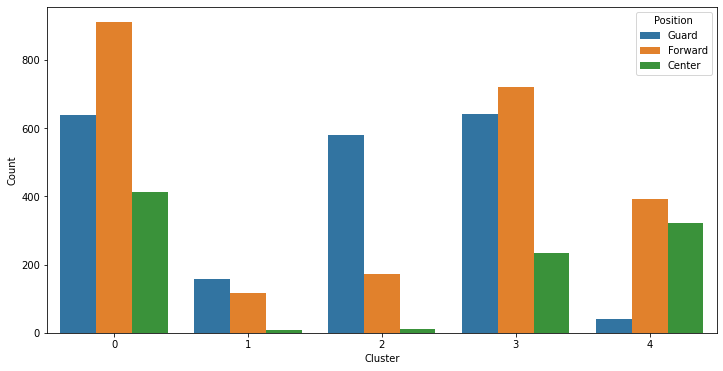

In [ ]:
plt.figure(figsize=(12,6))
sns.barplot(x="Cluster", y="Count", data=pb, hue = 'Position')

In [ ]:
for i in [group_0,group_1,group_2,group_3,group_4]:
  print('Cluster {} has {} guards.'.format(round(i['clusters'].mean()),round(i.groupby('Position: Guard').count().loc[1][1])))
  print('Cluster {} has {} forwards.'.format(round(i['clusters'].mean()),round(i.groupby('Position: Forward').count().loc[1][1])))
  print('Cluster {} has {} centers.'.format(round(i['clusters'].mean()),round(i.groupby('Position: Center').count().loc[1][1])))
  print('\n')

Cluster 0 has 639 guards.
Cluster 0 has 910 forwards.
Cluster 0 has 412 centers.


Cluster 1 has 159 guards.
Cluster 1 has 118 forwards.
Cluster 1 has 8 centers.


Cluster 2 has 578 guards.
Cluster 2 has 171 forwards.
Cluster 2 has 10 centers.


Cluster 3 has 642 guards.
Cluster 3 has 720 forwards.
Cluster 3 has 235 centers.


Cluster 4 has 41 guards.
Cluster 4 has 392 forwards.
Cluster 4 has 321 centers.




In [ ]:
careers.groupby('clusters').count()/guards.shape[0]

In [ ]:
guards.groupby('clusters').count()/guards.shape[0]
forwards.groupby('clusters').count()/forwards.shape[0]
centers.groupby('clusters').count()/centers.shape[0]

It might be interesting to look at things by position as well!

#Other


In [ ]:
sns.scatterplot(x=guards['AST/G'],y=guards['EFG%'],color='red')

NameError: ignored

In [ ]:
import numpy
from matplotlib import pyplot

g = [guards['PTS/G']]
f = [forwards['PTS/G']]
c = [centers['PTS/G']]

bins = numpy.linspace(0, 35, 100)
plt.figure(figsize=(10,10))
pyplot.hist(g, bins, alpha=0.5, label='g')
pyplot.hist(f, bins, alpha=0.5, label='f')
pyplot.hist(c, bins, alpha=0.5, label='c')
pyplot.legend(loc='upper right')
pyplot.show()

In [ ]:
plt.figure(figsize=(10,10))
#sns.distplot(x=careers['PTS/G'], color='red',hist=False, rug=True)
sns.displot(x=guards['PTS/G'], color='blue', rug=True)
sns.displot(x=forwards['PTS/G'], color='green', rug=True)
sns.displot(x=centers['PTS/G'], color='grey', rug=True)

In [ ]:
plt.figure(figsize=(15,10))
sns.scatterplot(x=careers['Last Year'], y=careers['3FGA/G'], hue=careers['G'], legend=False)

In [ ]:
careers.sort_values('3FGA/G', ascending=False).head(10)